In [1]:
%load_ext autoreload
%autoreload 2
from CO2_identify import *
from labeling import dataload,show3D
from mynetwork import CO2mask
from torch.utils.data import DataLoader
from scipy.ndimage import gaussian_filter
from torchvision.transforms.functional import resize

import torchvision
import torch
import torch.optim as optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
import json
from torchstat import stat

In [2]:
fn = '../define_path.txt'                                         #add your path
with open(fn) as f:
    lines = f.readlines()
for idx, line in enumerate(lines):
    if idx == 1:
        dir_co2 = line.split('=')[1][:-1]
    if idx == 3:
        dir_grid = line.split('=')[1][:-1]
    if idx == 5:
        root = line.split('=')[1][:-1]

# NN for CO2 mask identification

## Load datasets

In [3]:
# dataset information file names
pmf = 'pm_info.json'
pdf = 'patch_info'
pdfap = '.csv'

In [4]:
# load training dataset
train = dataset_patch(root,pmf,f'{pdf}_train{pdfap}')
Ntrain = len(train)
sliceitp = train.sliceitp
print(f'Training dataset size: {Ntrain}')

Training dataset size: 1500


In [5]:
# load validating dataset
valid = dataset_patch(root,pmf,f'{pdf}_valid{pdfap}')
Nvalid = len(valid)
print(f'Validating dataset size: {Nvalid}')

Validating dataset size: 132


In [7]:
# network path   #add your path    #add your path    #add your path
path_net = f'/scratch/gilbreth/pate2126/DKP_new/NNpred3D/train_fulllabel/co2_identify.pt'
path_bestnet = f'/scratch/gilbreth/pate2126/DKP_new/NNpred3D/train_fulllabel/co2_identify_best.pt'

## Display sampled patches in training and validating dataset

In [8]:
# define the sampled patches in training dataset for display
ndis_tr = 5
#train_id_list = np.random.choice(len(train),size=ndis_tr,replace=False)
train_id_list = np.linspace(0,Ntrain,ndis_tr+2,dtype=np.int16)[1:-1]
pst = patch_show(train,train_id_list)
print(f'train_id_list: {train_id_list}')
# define the sampled patches in valid dataset for display
ndis_va = 3
#valid_id_list = np.random.choice(len(valid),size=ndis_va,replace=False)
valid_id_list = np.linspace(0,Nvalid,ndis_va+2,dtype=np.int16)[1:-1]
psv = patch_show(valid,valid_id_list)
print(f'valid_id_list: {valid_id_list}')
# data patch resize shape
rs = valid.nsz
# sampling rate of epoch for display
epoch_itv = 20
# sampling rate of batch number for display
batch_itv = 10

train_id_list: [ 250  500  750 1000 1250]
valid_id_list: [33 66 99]


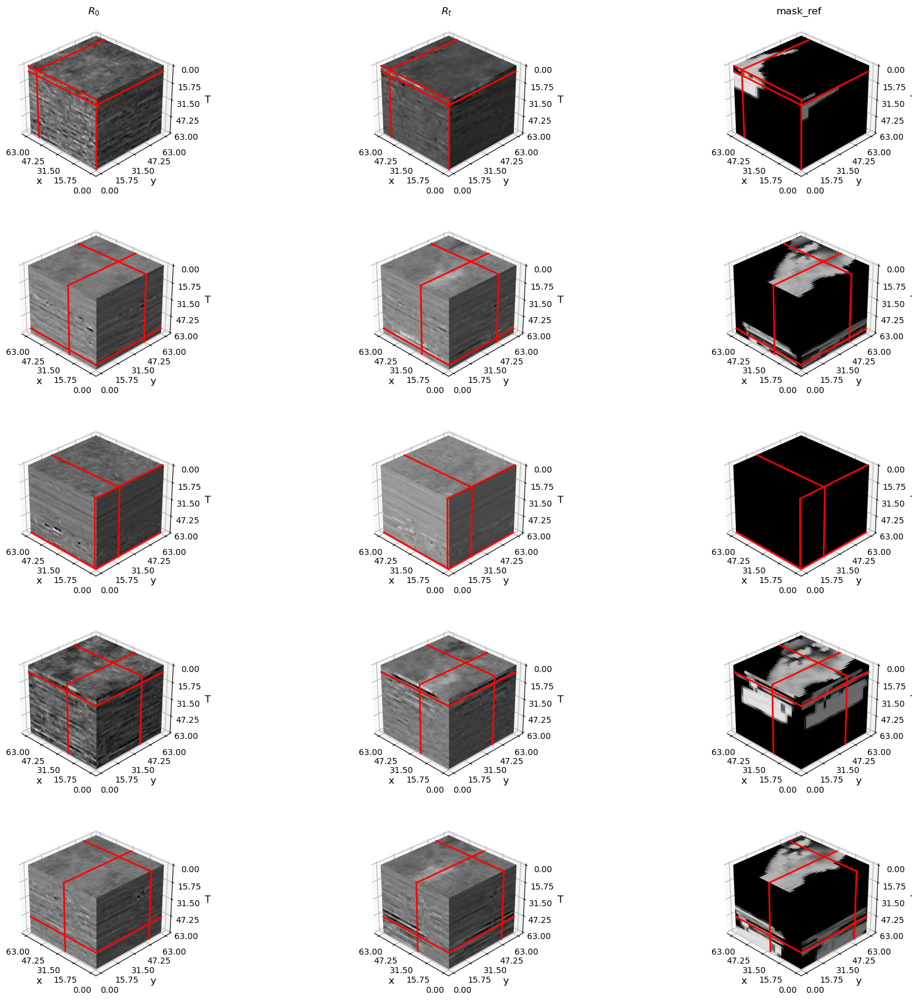

In [9]:
pst.view3d(rcstride=(2,2))

In [10]:
#psv.view3d(rcstride=(2,2))

## Training and validating

### Define training parameters

In [11]:
params = OrderedDict(
    lr = [.0002]
    ,batch_size = [30]
    ,shuffle = [True]
    ,epoch_num = [200]
    ,adadelta_num = [0]
)
cuda_gpu = True
gpus = [0]

In [12]:
# initilize run
M = RunManager(cuda_gpu)

In [13]:
# define sampler for loading valid_set
#valid_sampler = SubsetSampler(valid_id_list)
cpu_device = torch.device('cpu')

In [14]:
# define the resize class for combining the predicted validating patches
vrs3 = resize3d(Nvalid,D=valid.osz[0],H=valid.osz[1],W=valid.osz[2])

### Start training and validation

In [15]:
st = time.time()


Epoch No.: 0
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 0: 0.6045916771888733


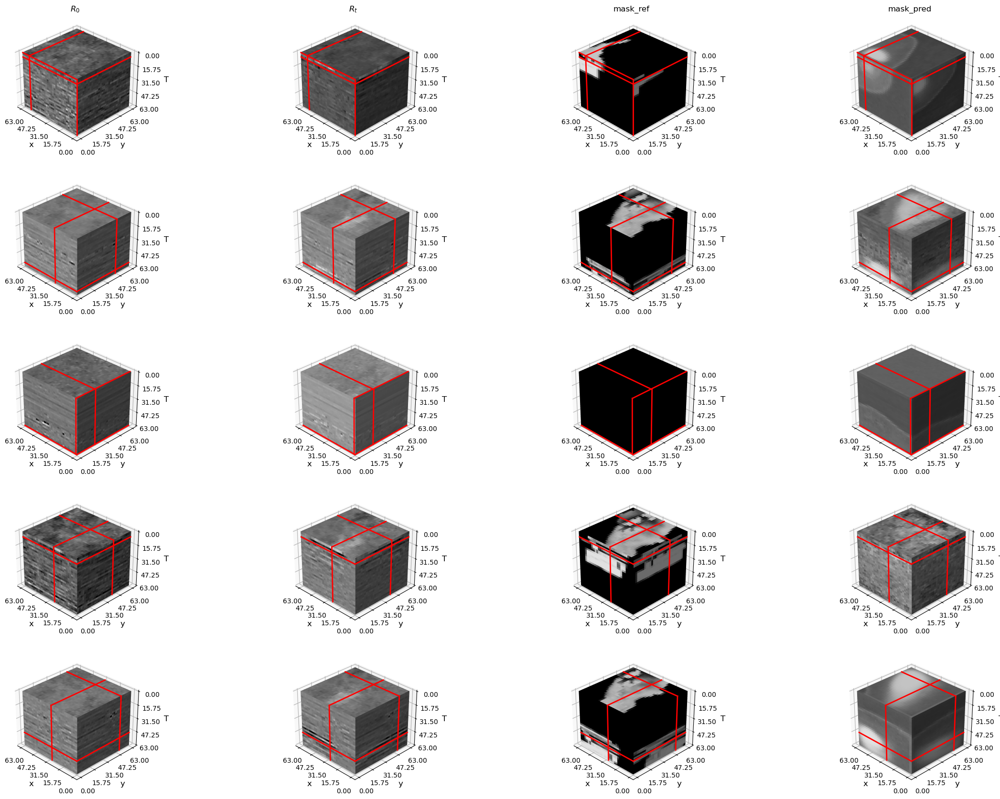

Mean validating loss for epoch 0: 0.4812457967888225


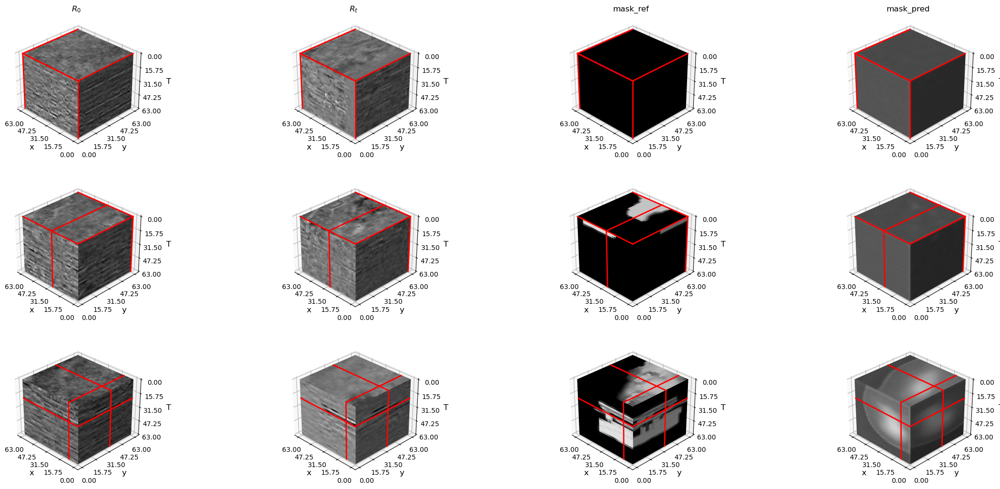


Epoch No.: 1
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 1: 0.13756151549518109
Mean validating loss for epoch 1: 0.07134300453419035

Epoch No.: 2
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 2: 0.06194700188934803
Mean validating loss for epoch 2: 0.06321665339849213

Epoch No.: 3
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 3: 0.05440400294959545
Mean validating loss for epoch 3: 0.05468885101039301

Epoch No.: 4
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Bat

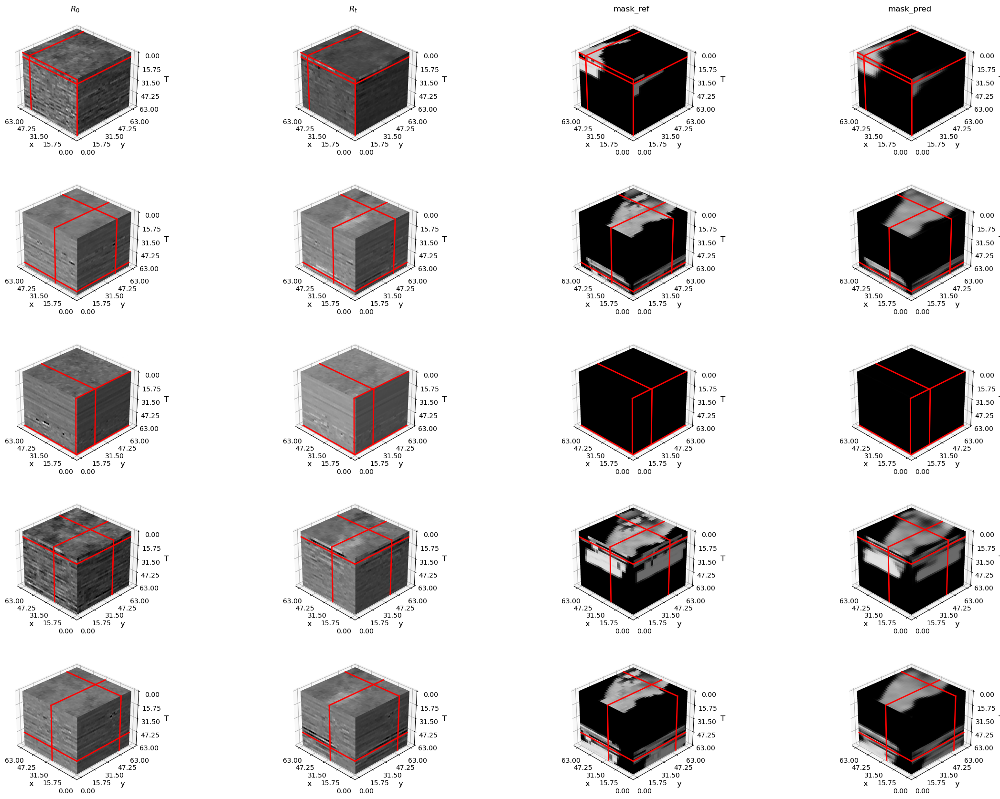

Mean validating loss for epoch 20: 0.03394281974231655


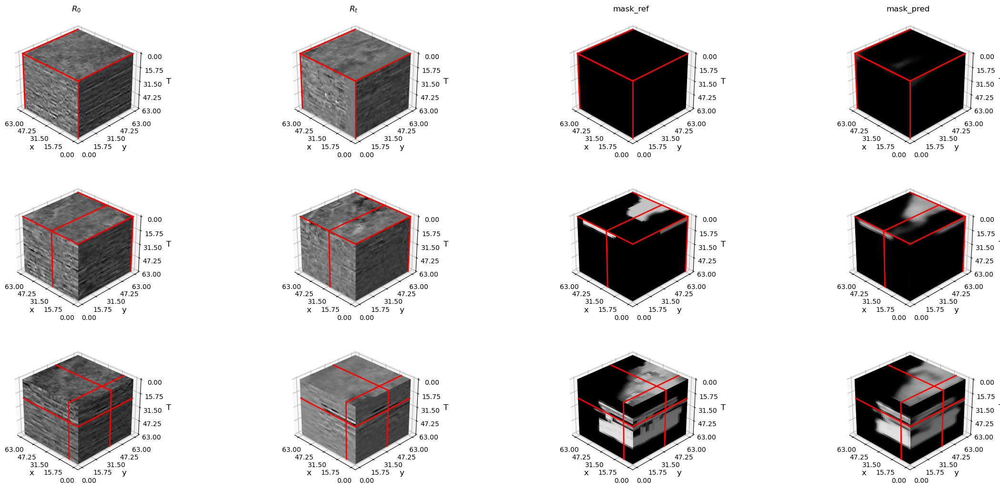


Epoch No.: 21
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 21: 0.030574722737073897
Mean validating loss for epoch 21: 0.03255940867926587

Epoch No.: 22
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 22: 0.03014711055904627
Mean validating loss for epoch 22: 0.03220140129666437

Epoch No.: 23
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 23: 0.030429841466248036
Mean validating loss for epoch 23: 0.03255047784610228

Epoch No.: 24
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30------------

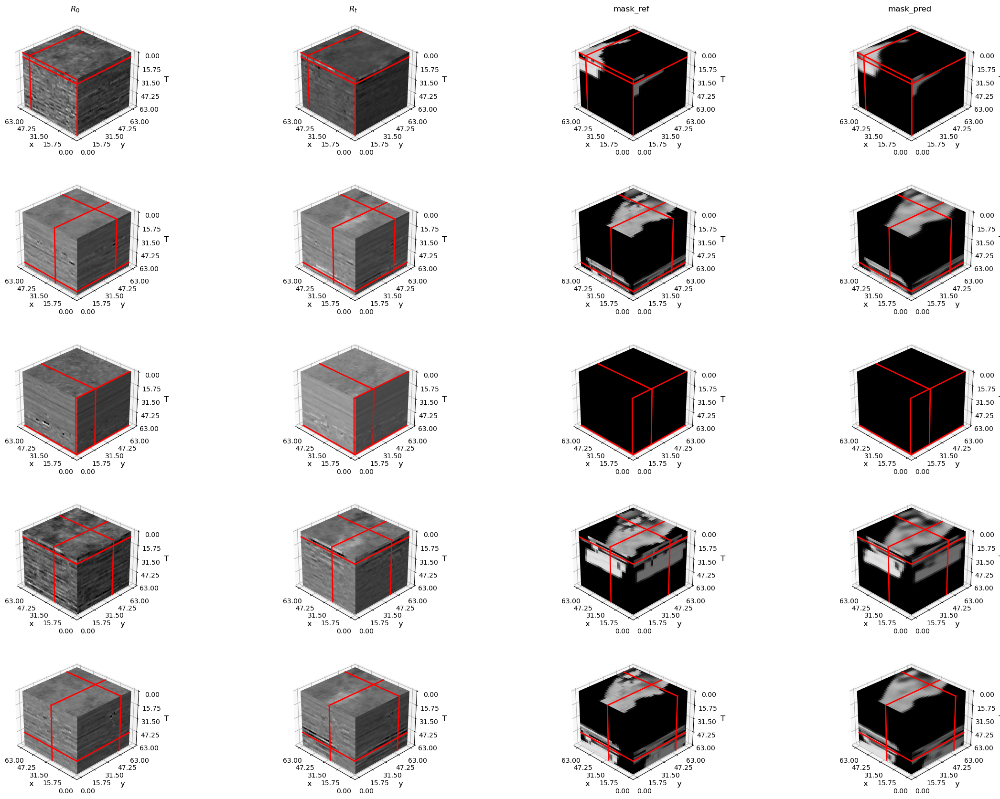

Mean validating loss for epoch 40: 0.029278256380083887


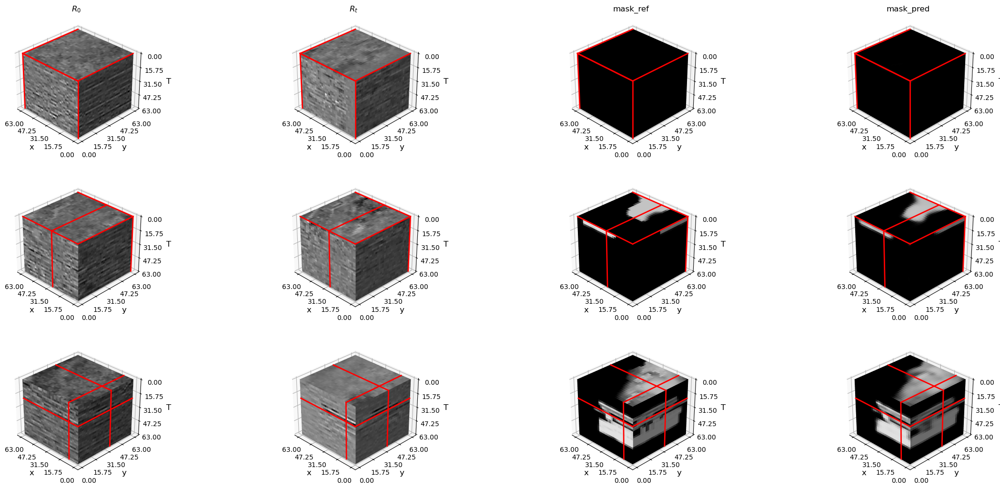


Epoch No.: 41
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 41: 0.027324818726629018
Mean validating loss for epoch 41: 0.029091272291473368

Epoch No.: 42
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 42: 0.02729489382356405
Mean validating loss for epoch 42: 0.028932960534637623

Epoch No.: 43
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 43: 0.027039278279989958
Mean validating loss for epoch 43: 0.028848144141110508

Epoch No.: 44
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30---------

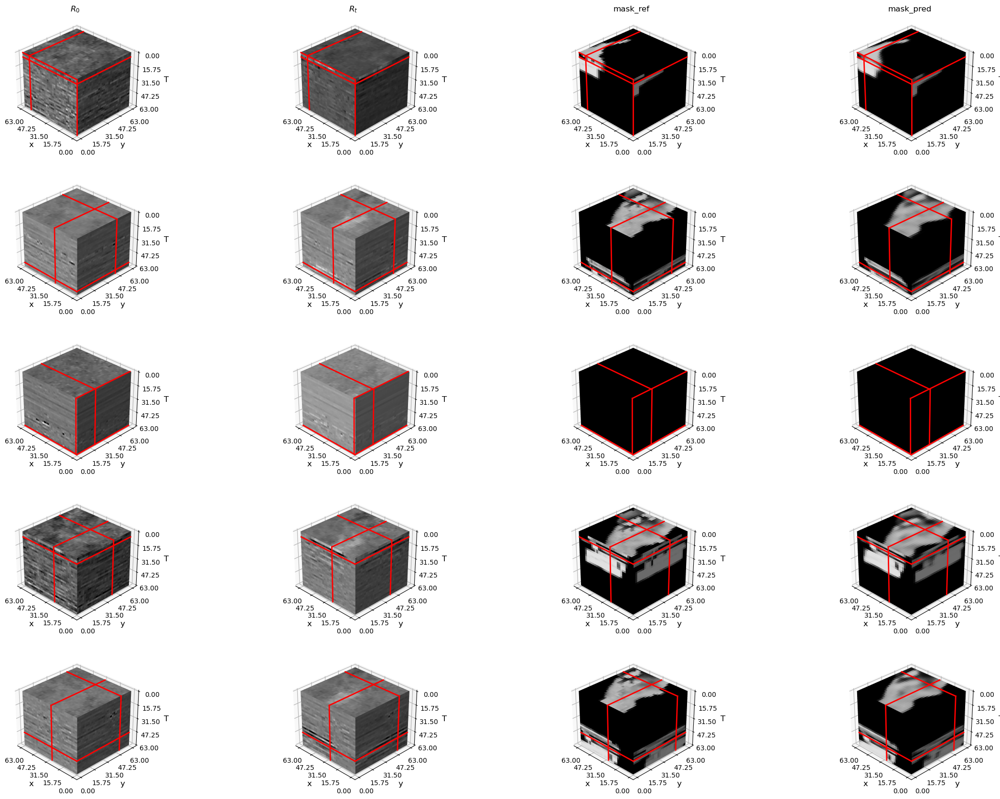

Mean validating loss for epoch 60: 0.027486717243763534


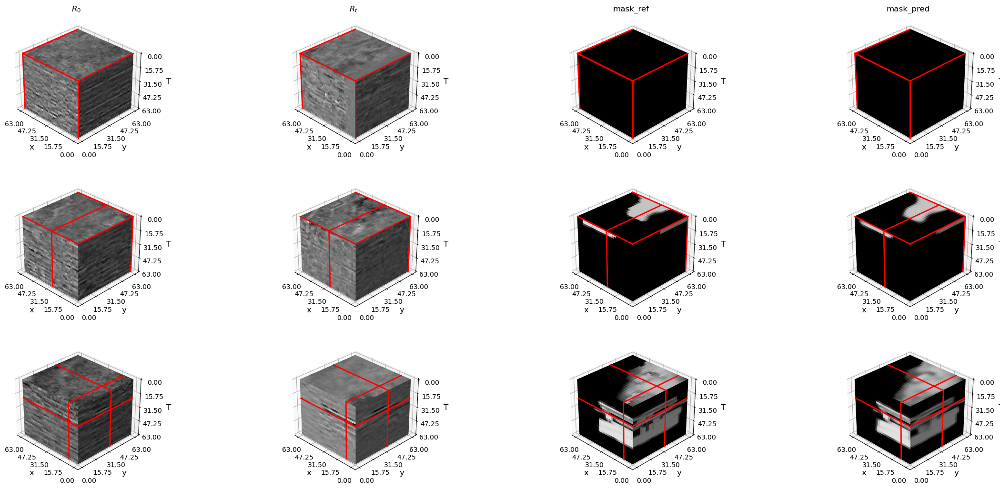


Epoch No.: 61
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 61: 0.025886256918311118
Mean validating loss for epoch 61: 0.027720392977988177

Epoch No.: 62
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 62: 0.025801287777721883
Mean validating loss for epoch 62: 0.02754828545518897

Epoch No.: 63
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 63: 0.02570237999781966
Mean validating loss for epoch 63: 0.027498811949044466

Epoch No.: 64
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30----------

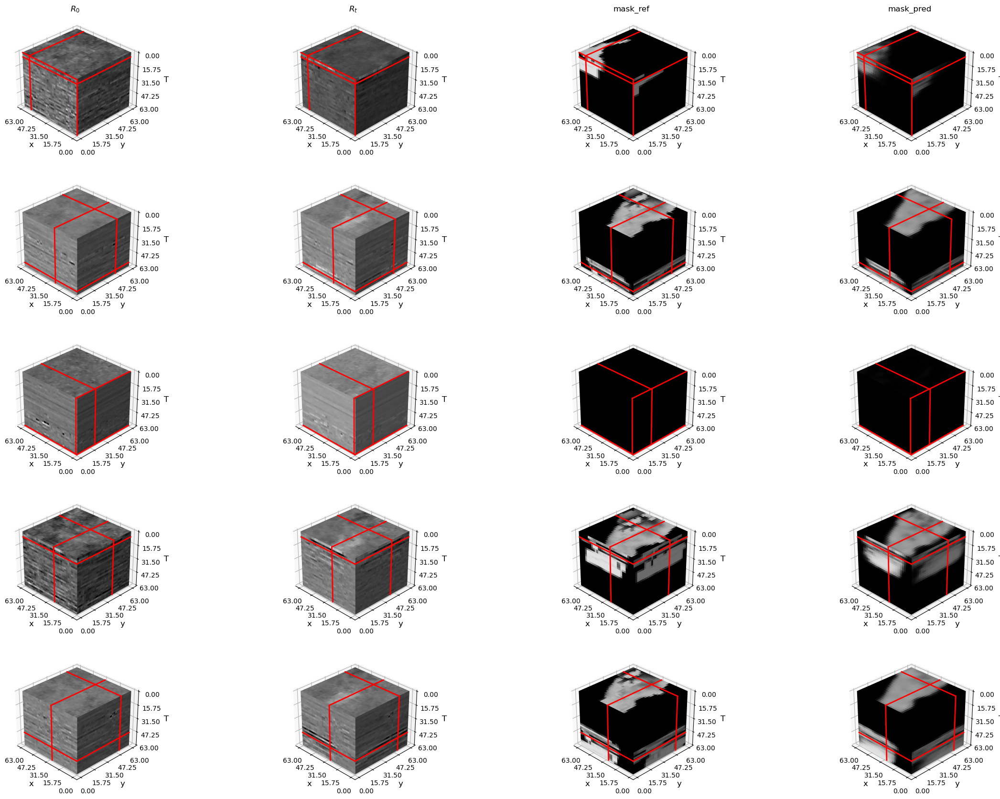

Mean validating loss for epoch 80: 0.04418267284265973


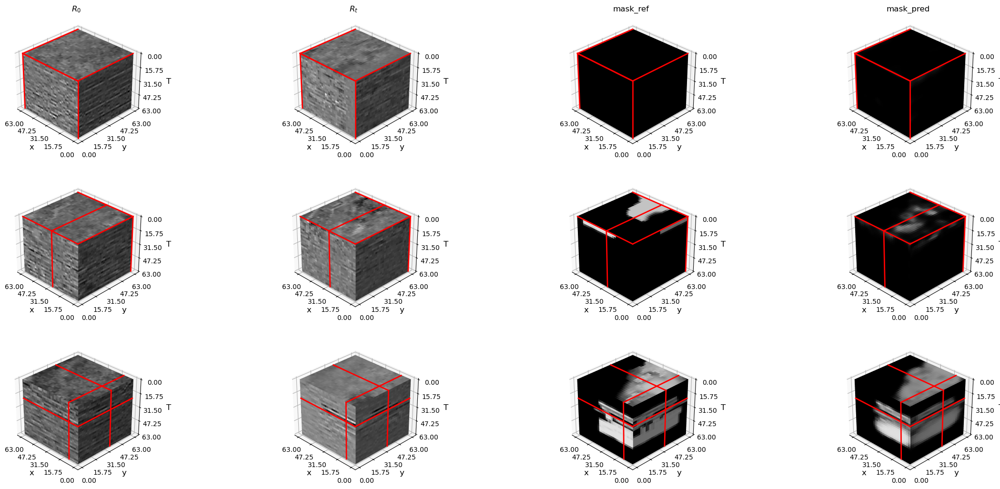


Epoch No.: 81
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 81: 0.04004488006234169
Mean validating loss for epoch 81: 0.043770951134237374

Epoch No.: 82
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 82: 0.039805563353002074
Mean validating loss for epoch 82: 0.042374458417973736

Epoch No.: 83
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 83: 0.03861884497106075
Mean validating loss for epoch 83: 0.04060460127551447

Epoch No.: 84
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30-----------

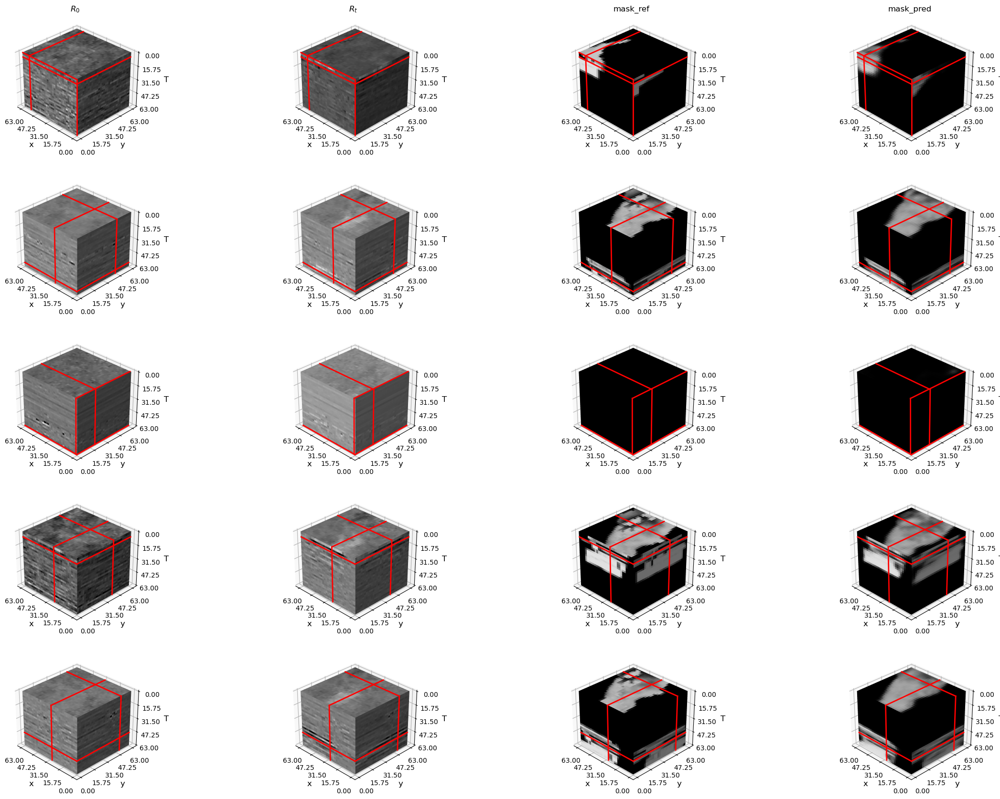

Mean validating loss for epoch 100: 0.03360447787087072


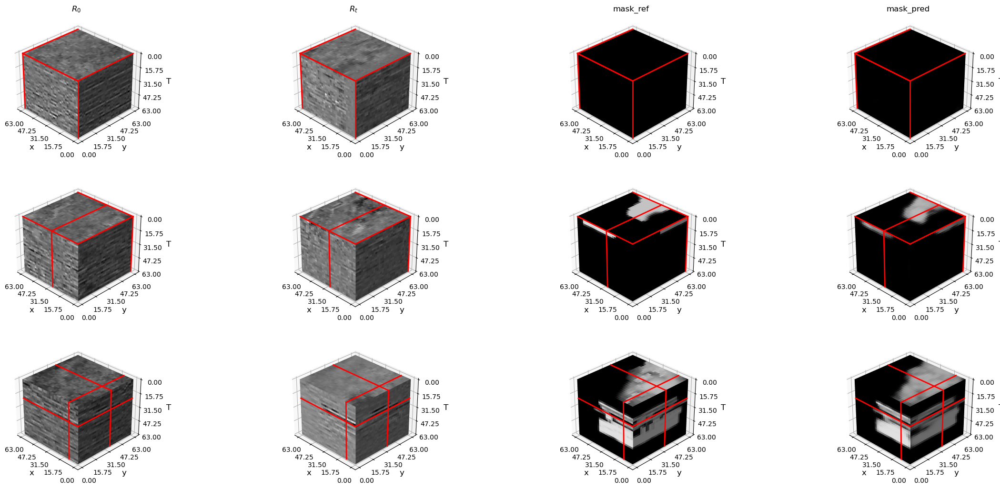


Epoch No.: 101
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 101: 0.030849380530416966
Mean validating loss for epoch 101: 0.03330227525227449

Epoch No.: 102
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 102: 0.030608031041920183
Mean validating loss for epoch 102: 0.03328280015425249

Epoch No.: 103
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 103: 0.030572703368961812
Mean validating loss for epoch 103: 0.03318654563785954

Epoch No.: 104
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30-

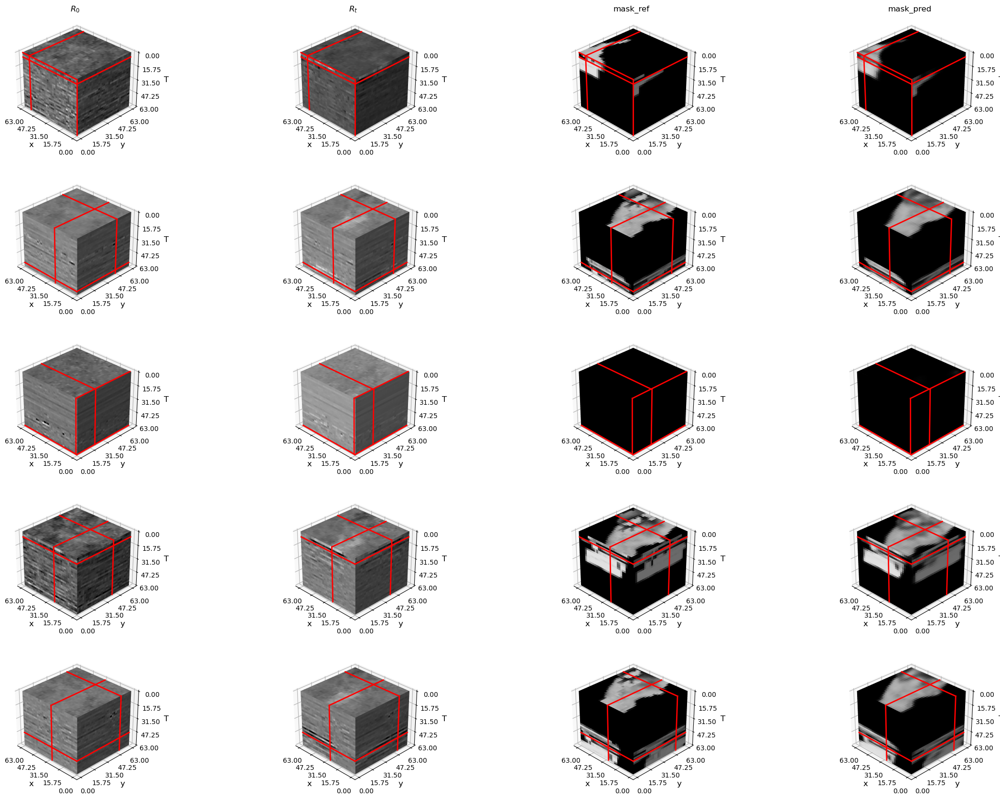

Mean validating loss for epoch 120: 0.030620359307663006


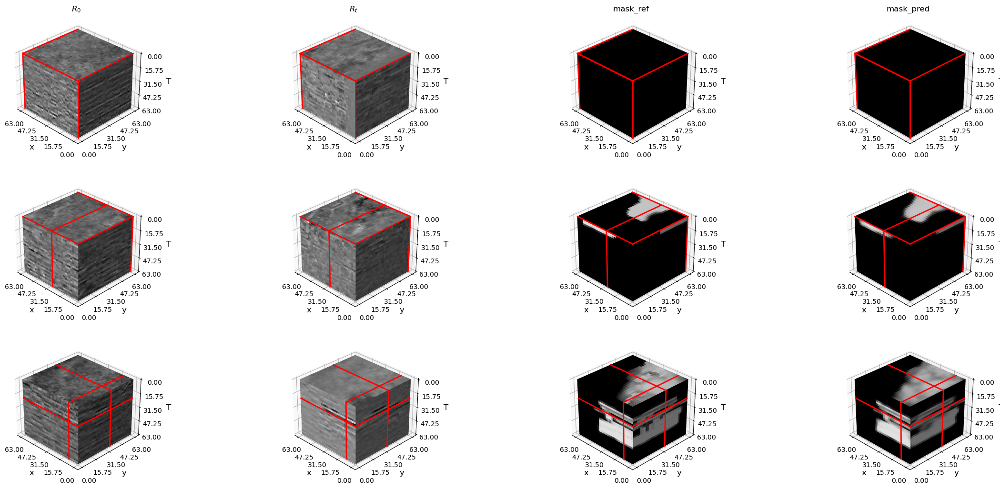


Epoch No.: 121
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 121: 0.028249895218759775
Mean validating loss for epoch 121: 0.030656823973086746

Epoch No.: 122
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 122: 0.028227748237550258
Mean validating loss for epoch 122: 0.030401893298734318

Epoch No.: 123
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 123: 0.028086741473525762
Mean validating loss for epoch 123: 0.030269161925058474

Epoch No.: 124
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 

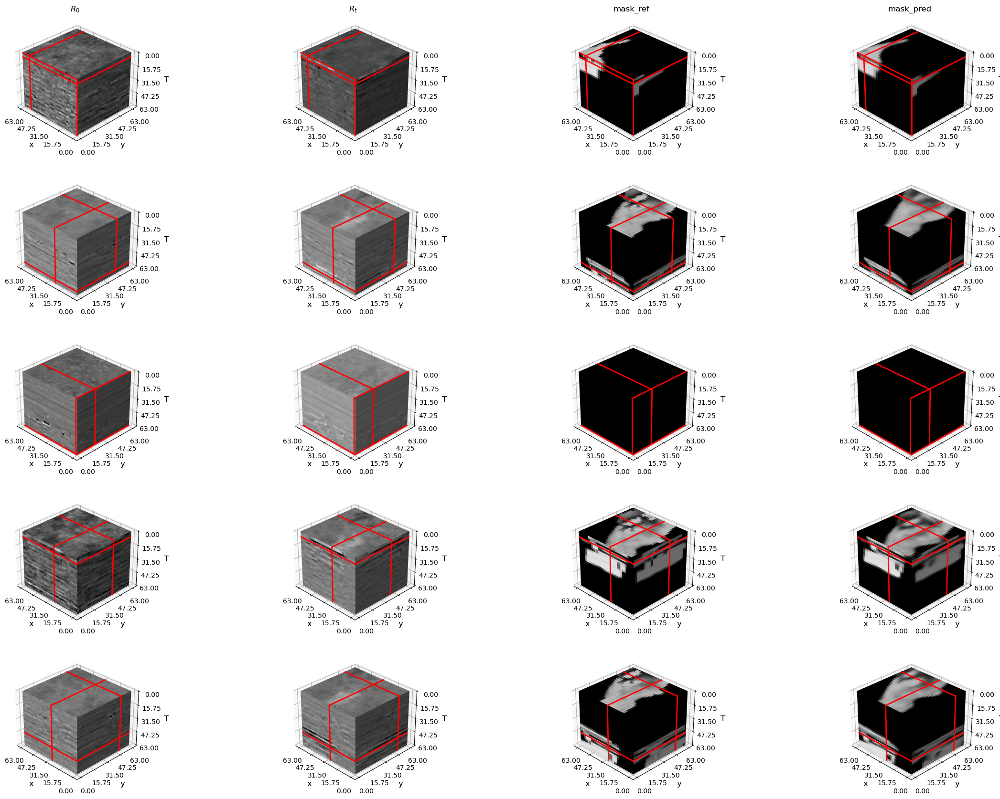

Mean validating loss for epoch 140: 0.029293347742747177


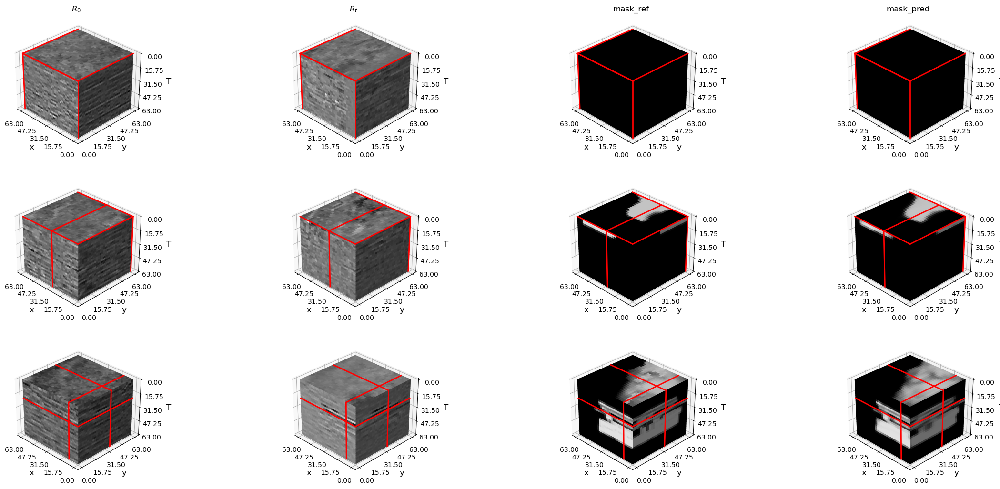


Epoch No.: 141
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 141: 0.02700445018708706
Mean validating loss for epoch 141: 0.029038024219599636

Epoch No.: 142
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 142: 0.02689723152667284
Mean validating loss for epoch 142: 0.02907138465988365

Epoch No.: 143
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 143: 0.026855128221213817
Mean validating loss for epoch 143: 0.02913994799283418

Epoch No.: 144
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--

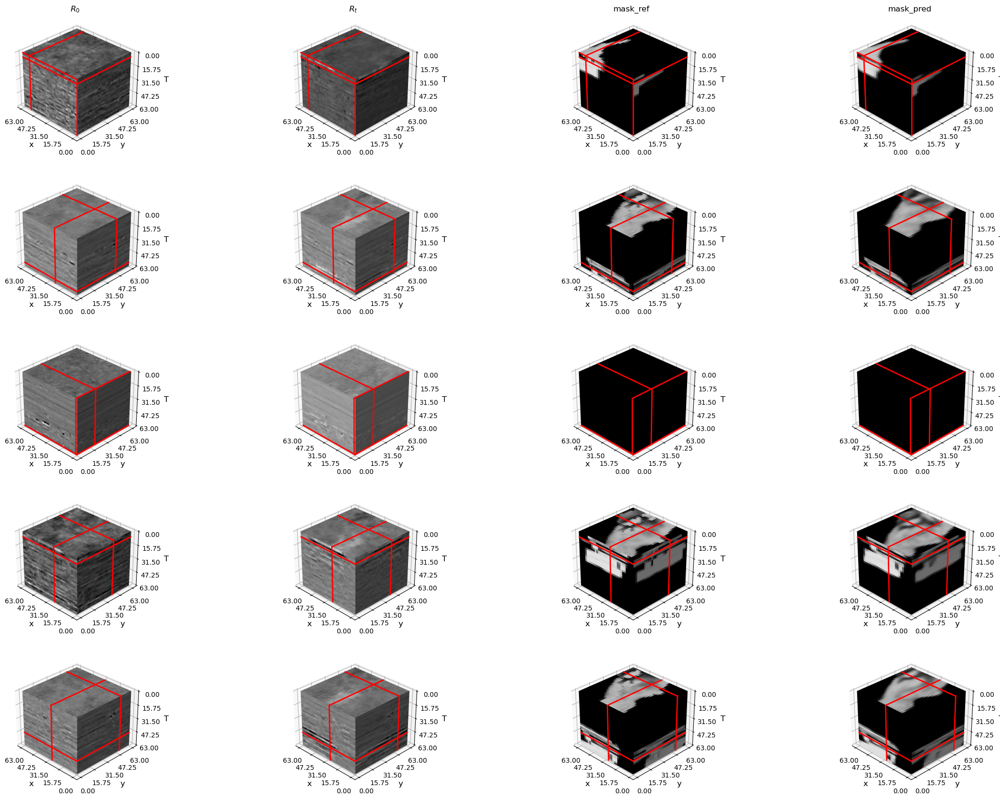

Mean validating loss for epoch 160: 0.028324085076085546


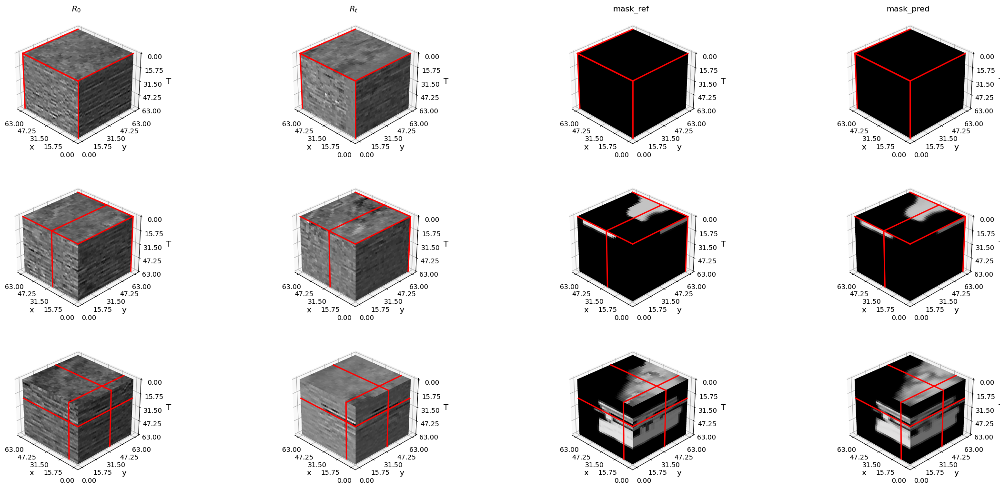


Epoch No.: 161
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 161: 0.026156171001493932
Mean validating loss for epoch 161: 0.02824320529841564

Epoch No.: 162
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 162: 0.026166806146502495
Mean validating loss for epoch 162: 0.028535858981988647

Epoch No.: 163
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 163: 0.028921412713825704
Mean validating loss for epoch 163: 0.03231808678670363

Epoch No.: 164
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30

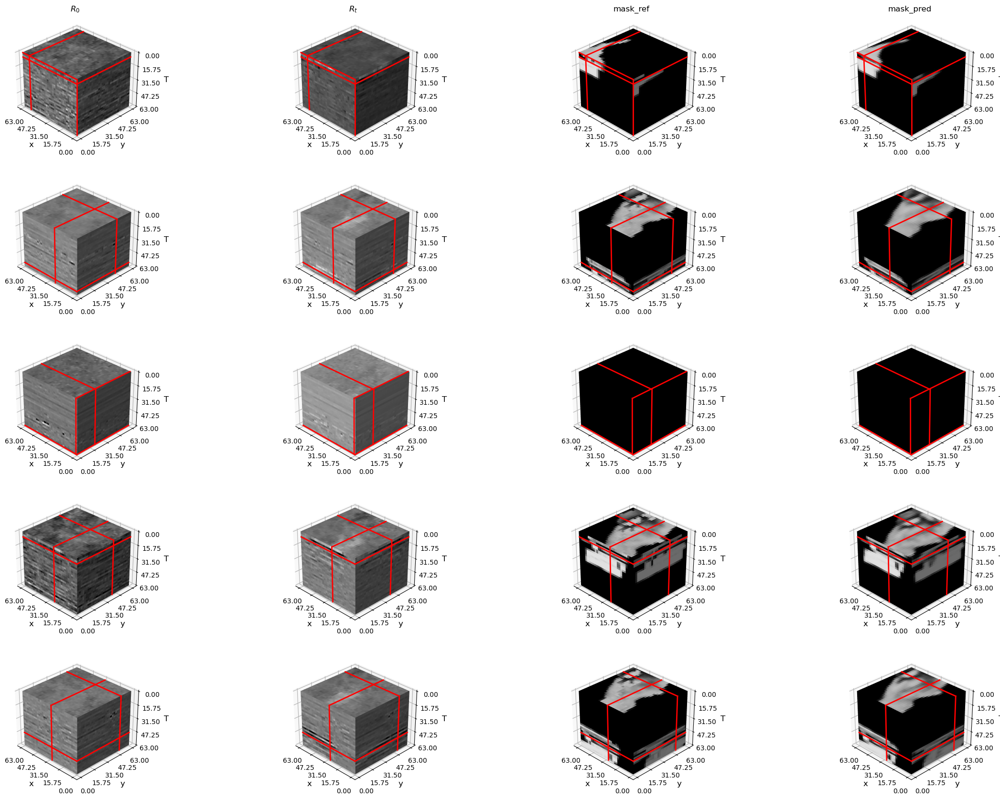

Mean validating loss for epoch 180: 0.02762156915427609


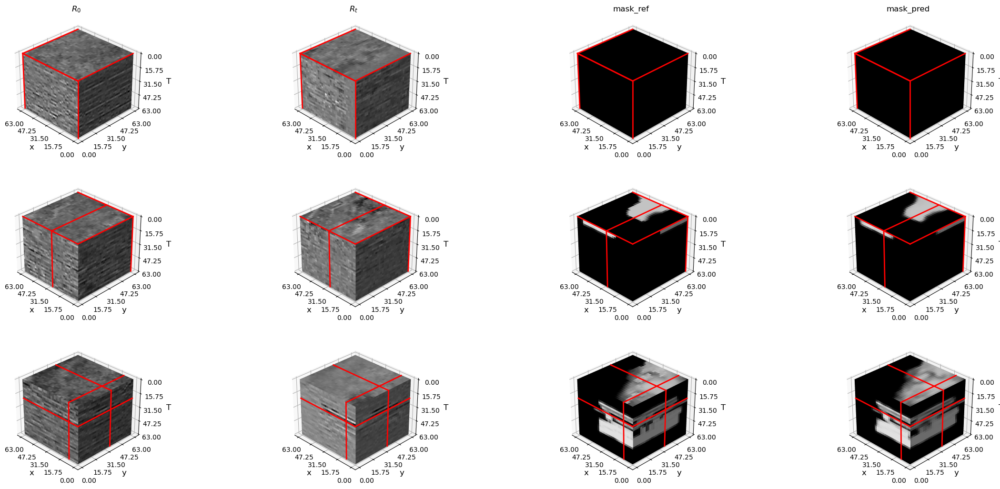


Epoch No.: 181
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 181: 0.025703301727771757
Mean validating loss for epoch 181: 0.027847287541424685

Epoch No.: 182
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 182: 0.025955258533358574
Mean validating loss for epoch 182: 0.028128071942112663

Epoch No.: 183
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch 183: 0.025913982950150967
Mean validating loss for epoch 183: 0.02789803221821785

Epoch No.: 184
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 3

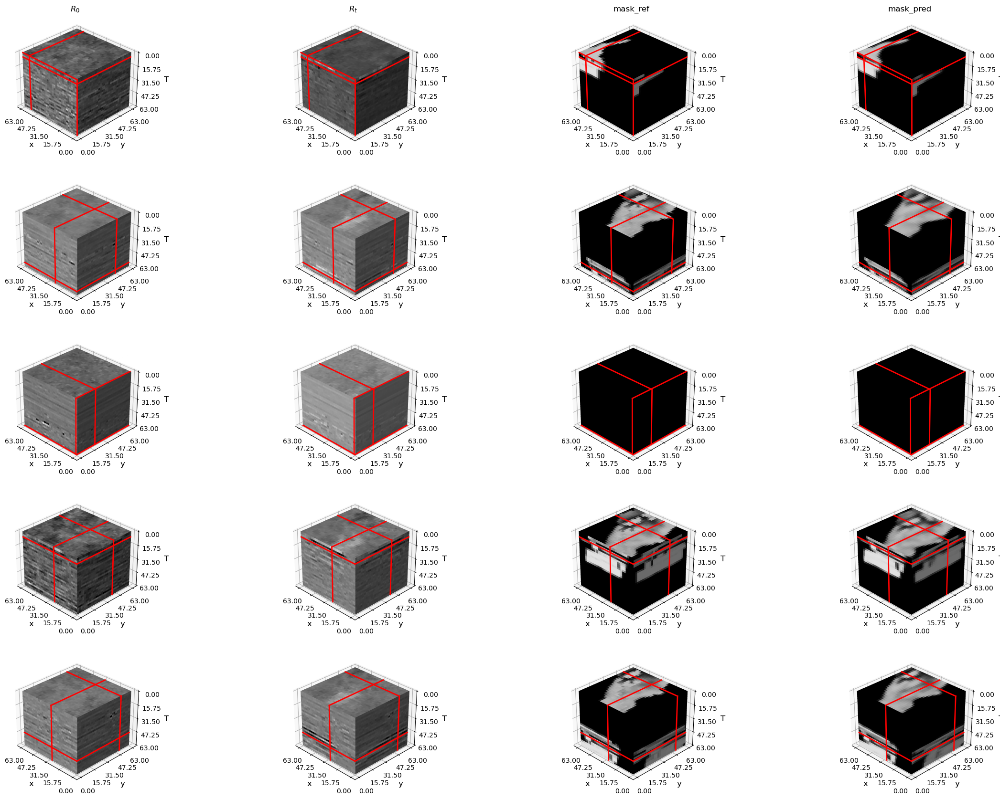

Mean validating loss for epoch 199: 0.027352818541906097


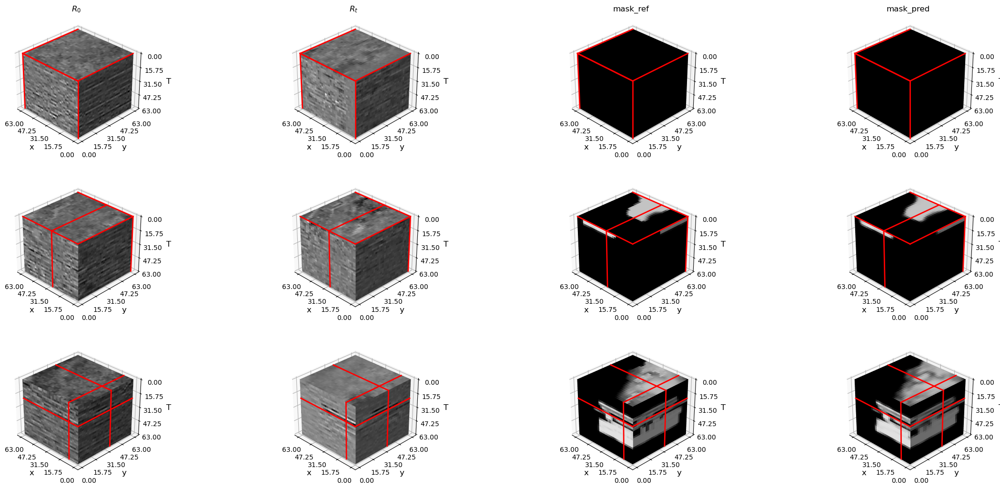

In [16]:
import torch
import torch.nn.functional as F
from torch.utils.data import DataLoader
import numpy as np
import os

# Enable synchronous CUDA errors for better debugging
os.environ["CUDA_LAUNCH_BLOCKING"] = "1"

for run in RunBuilder.get_runs(params):
    # Initialize the network
    nw = 2
    network = CO2mask()

    # Optional: load pretrained model
    # network.load_state_dict(torch.load(path_bestnet, map_location=cpu_device))
    # network = network.train()

    if cuda_gpu:
        try:
            # Validate parameters for NaN or Inf before using DataParallel
            for name, param in network.named_parameters():
                if torch.isnan(param).any() or torch.isinf(param).any():
                    raise ValueError(f"Invalid parameter detected in {name}")

            network = torch.nn.DataParallel(network, device_ids=gpus).cuda()
            nw = 0
        except RuntimeError as e:
            print("Error during DataParallel initialization:", e)
            continue  # Skip this run if initialization fails

    # Set up DataLoaders
    loader_train = DataLoader(train, batch_size=run.batch_size, shuffle=run.shuffle, num_workers=nw, drop_last=False)
    loader_valid = DataLoader(valid, batch_size=run.batch_size, shuffle=False, num_workers=nw, drop_last=False)

    optimizer = torch.optim.Adadelta(network.parameters())
    TrLoss_list, VaLoss_list = [], []
    Bloss, Bloss_epNo = float('inf'), 0

    M.begin_run(run, network, loader_train)
    
    for epoch in range(run.epoch_num):
        print(f'\nEpoch No.: {epoch}')
        M.begin_epoch()
        Loss, Np, C = 0, 0, 0
        Trpred = np.zeros((ndis_tr, rs[0], rs[1], rs[2]))
        Vapred = np.zeros((ndis_va, rs[0], rs[1], rs[2]))

        if epoch == run.adadelta_num:
            optimizer = torch.optim.Adam(network.parameters(), run.lr)

        # ---- Training Phase ----
        for batch in loader_train:
            if C % batch_itv == 0:
                print(f'Batch No. {C}--------------------')
            C += 1

            if sliceitp:
                R0t, Mask, Weight, idx = batch
            else:
                R0t, Mask, idx = batch

            bs = len(idx)
            Np += bs
            cp = findtrace(train_id_list, idx.tolist())

            if cuda_gpu:
                R0t, Mask = R0t.to("cuda"), Mask.to("cuda")
                if sliceitp:
                    Weight = Weight.to("cuda")

            Mask = Mask.float().clamp(0, 1)  # Ensure valid input range
            pMask = network(R0t)

            for c, p in cp:
                Trpred[c] = pMask[p][0].cpu().detach().numpy()

            loss = F.binary_cross_entropy(pMask, Mask, weight=Weight) if sliceitp else F.binary_cross_entropy(pMask, Mask)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            Loss = track_loss_out(Loss, loss, bs)

        TrLoss_list.append(Loss / Np)
        print(f'Mean training loss for epoch {epoch}: {Loss / Np}')
        if (epoch % epoch_itv == 0) or (epoch == run.epoch_num - 1):
            pst.view3d(Trpred, rcstride=(2, 2))

        torch.save(network.module.state_dict(), path_net)

        # ---- Validation Phase ----
        networkvalid = network.eval()
        Loss, Np = 0, 0
        for batch in loader_valid:
            if valid.sliceitp:
                R0t, Mask, Weight, idx = batch
            else:
                R0t, Mask, idx = batch

            bs = len(idx)
            Np += bs
            cp = findtrace(valid_id_list, idx.tolist())

            if cuda_gpu:
                R0t, Mask = R0t.to("cuda"), Mask.to("cuda")
                if valid.sliceitp:
                    Weight = Weight.to("cuda")

            Mask = Mask.float().clamp(0, 1)

            with torch.no_grad():
                pMask = networkvalid(R0t)

            for c, p in cp:
                Vapred[c] = pMask[p][0].cpu().detach().numpy()

            loss = F.binary_cross_entropy(pMask, Mask, weight=Weight) if valid.sliceitp else F.binary_cross_entropy(pMask, Mask)
            Loss = track_loss_out(Loss, loss, bs)

        VaLoss_list.append(Loss / Np)
        print(f'Mean validating loss for epoch {epoch}: {Loss / Np}')

        if epoch > 0 and VaLoss_list[-1] < Bloss:
            torch.save(network.module.state_dict(), path_bestnet)
            Bloss = VaLoss_list[-1]
            Bloss_epNo = epoch

        if (epoch % epoch_itv == 0) or (epoch == run.epoch_num - 1):
            psv.view3d(Vapred, rcstride=(2, 2))



In [17]:
et = time.time()

In [18]:
print(f'Training time: {et-st} s = {(et-st)/3600} h')

Training time: 4011.8950057029724 s = 1.1144152793619369 h


(0.0, 0.5)

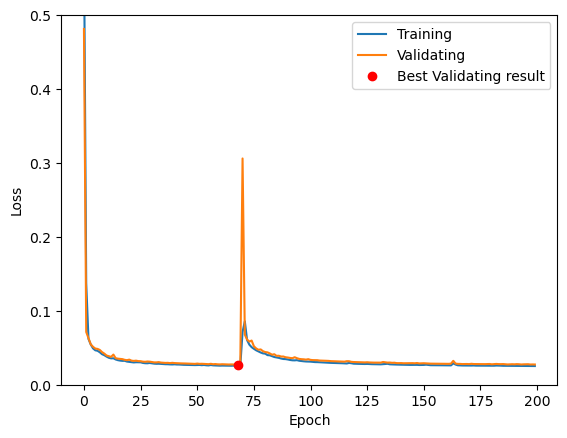

In [19]:
# plot the training and validating loss
epoch = np.arange(run.epoch_num)
fig,ax = plt.subplots(1,1)
ax.plot(epoch,TrLoss_list,label='Training')
ax.plot(epoch,VaLoss_list,label='Validating')
ax.plot(Bloss_epNo,Bloss,'ro',label='Best Validating result')
ax.legend()
ax.set_xlabel('Epoch')
ax.set_ylabel('Loss')
ax.set_ylim(0,0.5)

In [20]:
 #add your path     #add your path     #add your path    
np.array(TrLoss_list,dtype=np.float32).tofile(f'/scratch/gilbreth/pate2126/DKP_new/NNpred3D/train_fulllabel/train_loss.dat')

In [21]:
 #add your path      #add your path       #add your path
np.array(VaLoss_list,dtype=np.float32).tofile(f'/scratch/gilbreth/pate2126/DKP_new/NNpred3D/train_fulllabel/valid_loss.dat')

## Perform testing

In [22]:
fn = '../define_path.txt'
with open(fn) as f:
    lines = f.readlines()
for idx, line in enumerate(lines):
    if idx == 1:
        dir_co2 = line.split('=')[1][:-1]
    if idx == 9:
        testpath = line.split('=')[1][:-1]

### define the network and basic information for testing

In [23]:
# testing datasets
yearlist = ['1999_b01_t01','2001_b01_t01',
            '2004_b01_t07','2006_b01_t07',
            '2008_b01_t08',
            '2010_b01_t10','2010_b01_t11','2010_b10_t10','2010_b10_t11']

In [24]:
# reference dataset grid path
xydfn = f'{dir_co2}/10p10/data/10p10nea.sgy'      #add your path
# load the reference dataset head
Dr = dataload(fn=xydfn)
DD = (Dr.nx,Dr.ny,Dr.nt)

Total trace number: 150909
Sample number along each trace: 1001
Sampling interval along each trace: 0.002 s
data arrangement: 269 (number of ensembles) x 561 (trace number per ensemble) x 1001 (sample number per trace)


In [25]:
# network path
path_bestnet = f'/scratch/gilbreth/pate2126/DKP_new/NNpred3D/train_fulllabel/co2_identify_best.pt'     #add your path
cuda_gpu = True
gpus = [0]

In [26]:
# load the network
networktest = CO2mask()
networktest.load_state_dict(torch.load(path_bestnet,map_location=torch.device('cpu')))
networktest = networktest.eval()
if cuda_gpu:
    networktest = torch.nn.DataParallel(networktest, device_ids=gpus).cuda()
    nw = 0
networktest = networktest.eval()

/tmp/ipykernel_130633/3059158192.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  networktest.load_state_dict(torch.load(path_bestnet,map_location=torch.device('cpu')))


In [27]:
# fixed dataset information file names
pmf = 'pm_info.json'
pdf = 'patch_info.csv'
# batch_size of testing dataset
bs = 20
# sampling number for patch display
ndis_ts = 3

In [28]:
# reference mask dataset for training and validating
mkfn = f'/scratch/gilbreth/pate2126/DKP_new/resources/label/masks.dat'        #add your path
# readin CO2 mask
masks = np.fromfile(f'{mkfn}',dtype=np.float32)
masks = np.reshape(masks,DD)
# find the slice indices for display
MI = np.argmax(np.sum(masks,axis=(1,2)))
MX = np.argmax(np.sum(masks,axis=(0,2)))
MT = np.argmax(np.sum(masks,axis=(0,1)))
MIXT = (MI,MX,MT)

In [29]:
print (mkfn)

/scratch/gilbreth/pate2126/DKP_new/resources/label/masks.dat


### start to test dataset for all years

Testing year: 1999_b01_t01
Testing dataset size: 90
test_id_list for 1999_b01_t01: [22 45 67]
Runtime for 1999_b01_t01: 6.023754835128784 s


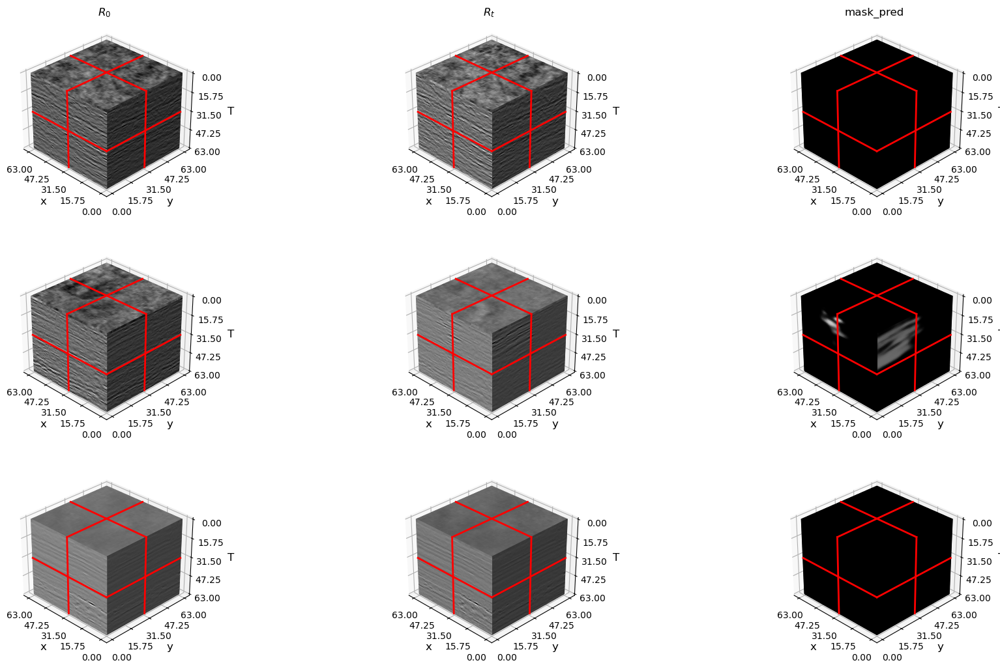

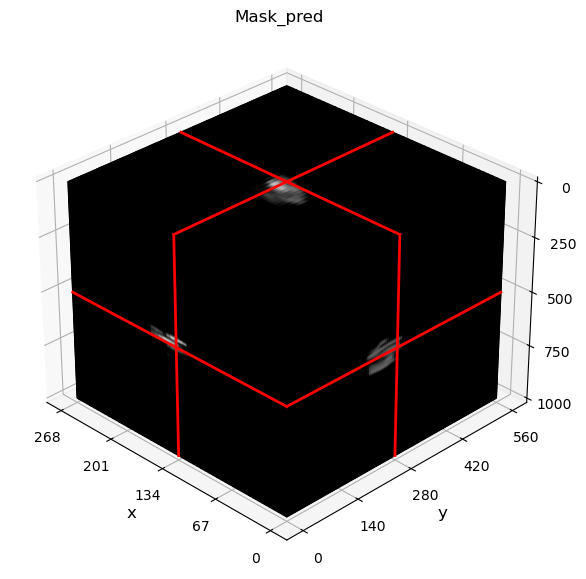

Horizontal slice Artifact above 600 ms for 1999_b01_t01:


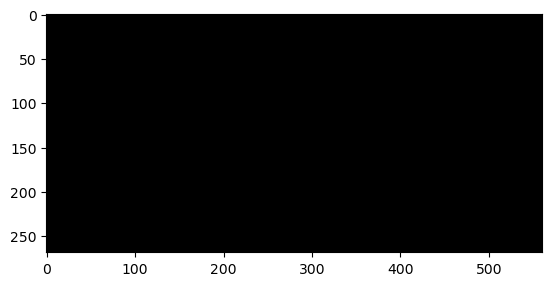

Horizontal slice Artifact below 1200 ms for 1999_b01_t01:


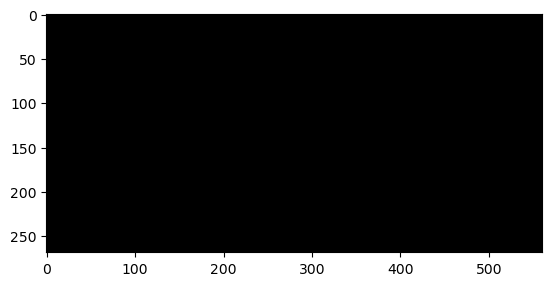

Inline assemble No. 134 for 1999_b01_t01:


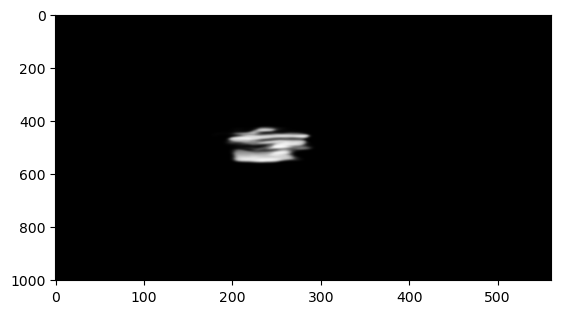

Testing year: 2001_b01_t01
Testing dataset size: 90
test_id_list for 2001_b01_t01: [22 45 67]
Runtime for 2001_b01_t01: 3.368546724319458 s


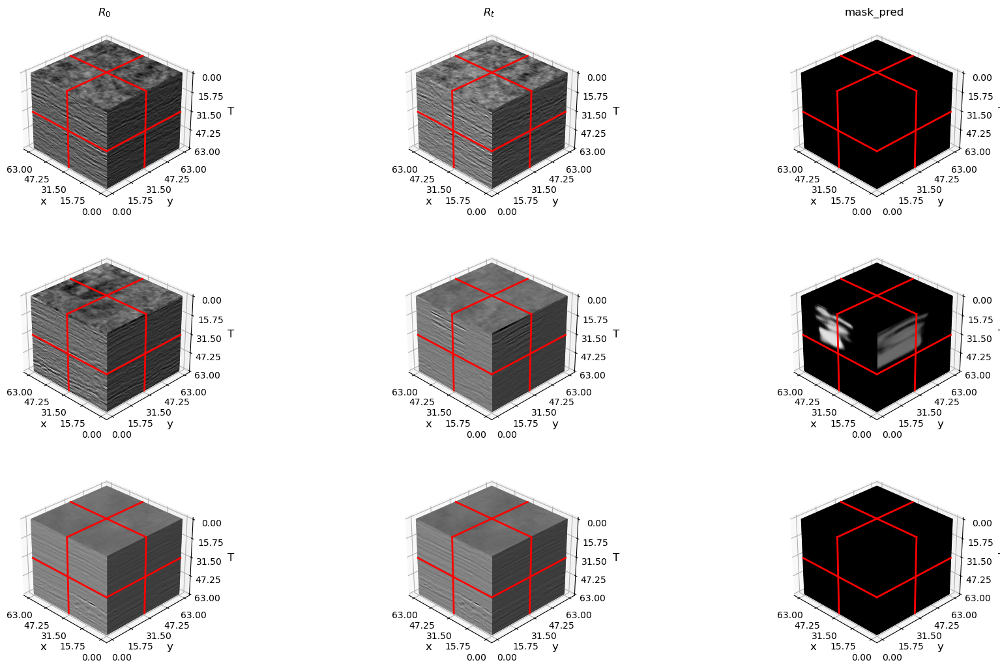

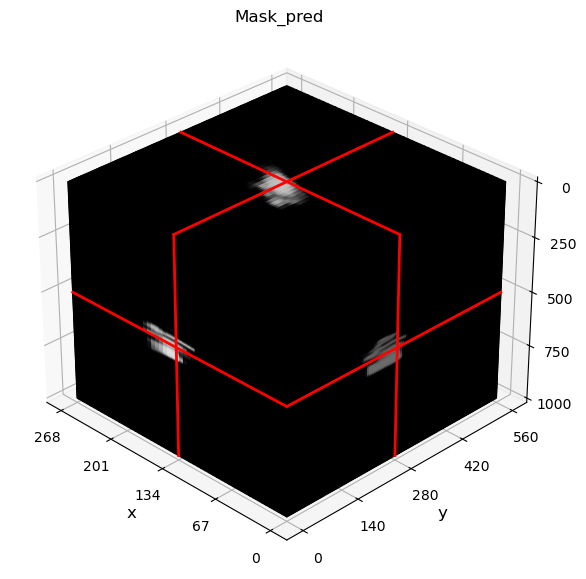

Horizontal slice Artifact above 600 ms for 2001_b01_t01:


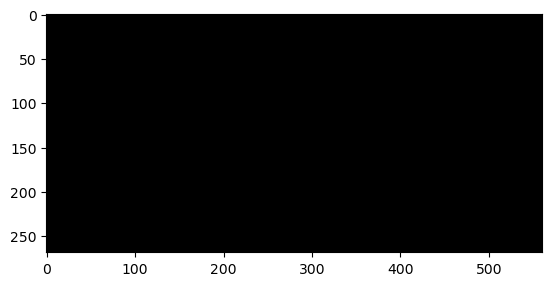

Horizontal slice Artifact below 1200 ms for 2001_b01_t01:


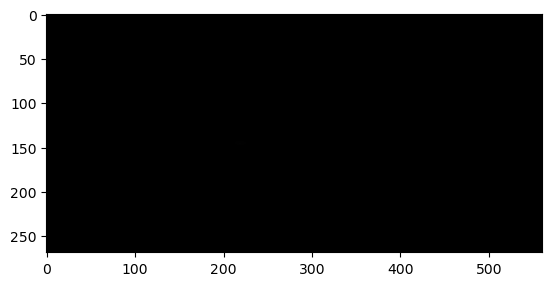

Inline assemble No. 134 for 2001_b01_t01:


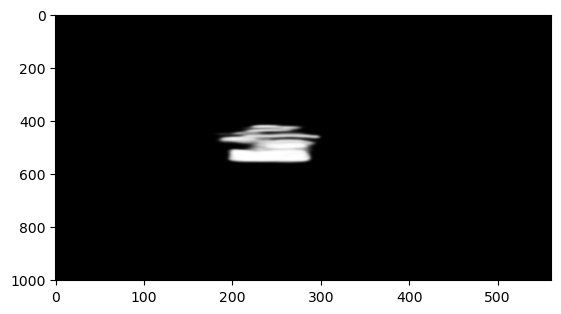

Testing year: 2004_b01_t07
Testing dataset size: 90
test_id_list for 2004_b01_t07: [22 45 67]
Runtime for 2004_b01_t07: 3.0796868801116943 s


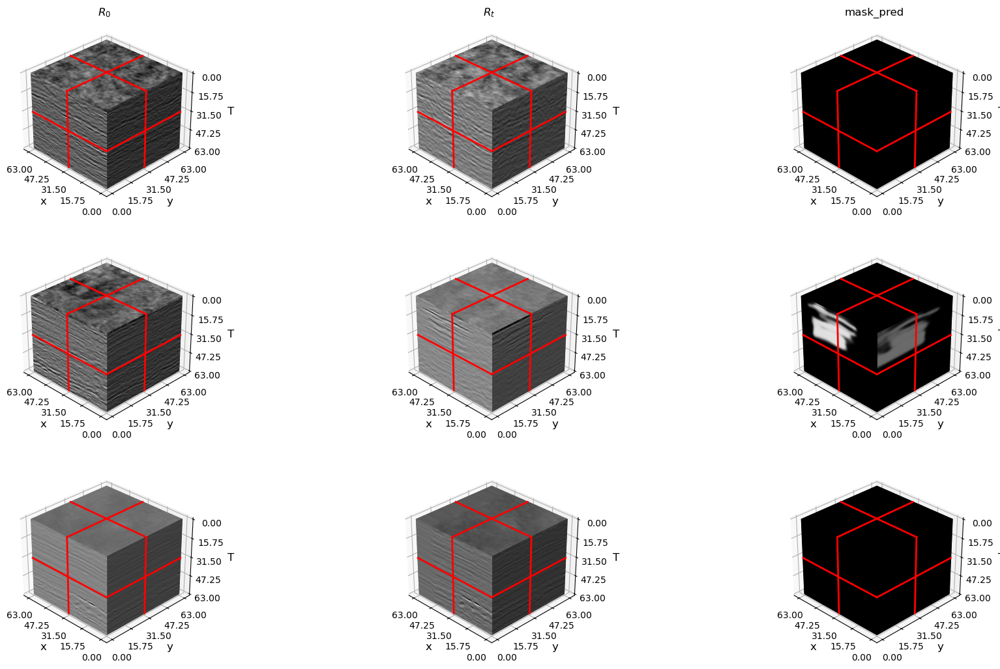

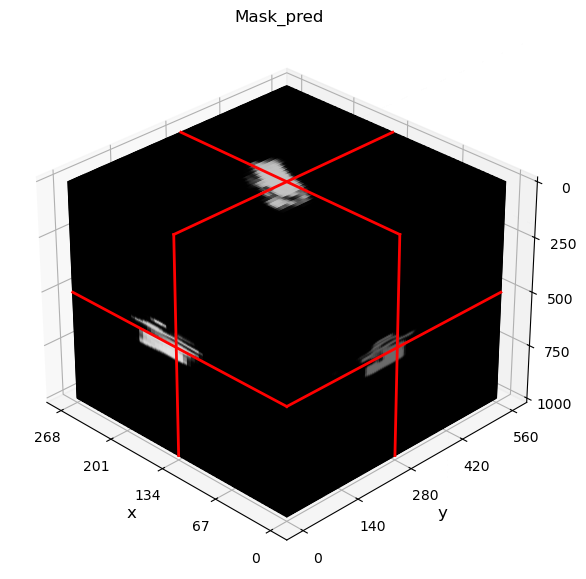

Horizontal slice Artifact above 600 ms for 2004_b01_t07:


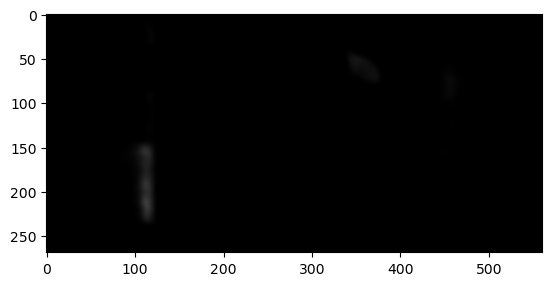

Horizontal slice Artifact below 1200 ms for 2004_b01_t07:


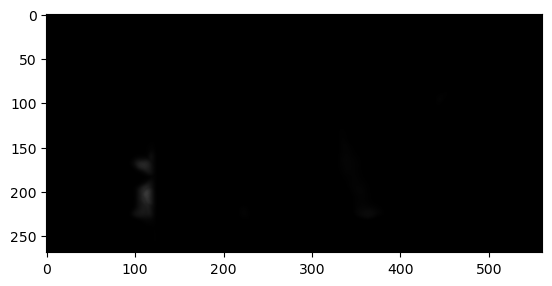

Inline assemble No. 134 for 2004_b01_t07:


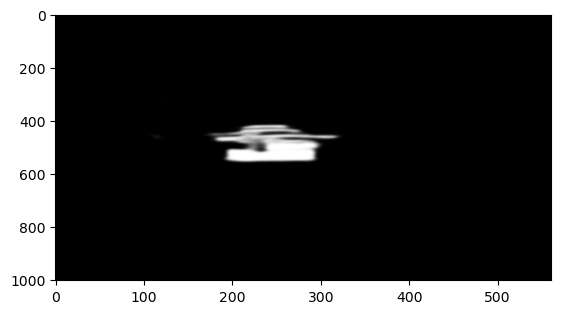

Testing year: 2006_b01_t07
Testing dataset size: 90
test_id_list for 2006_b01_t07: [22 45 67]
Runtime for 2006_b01_t07: 3.558701753616333 s


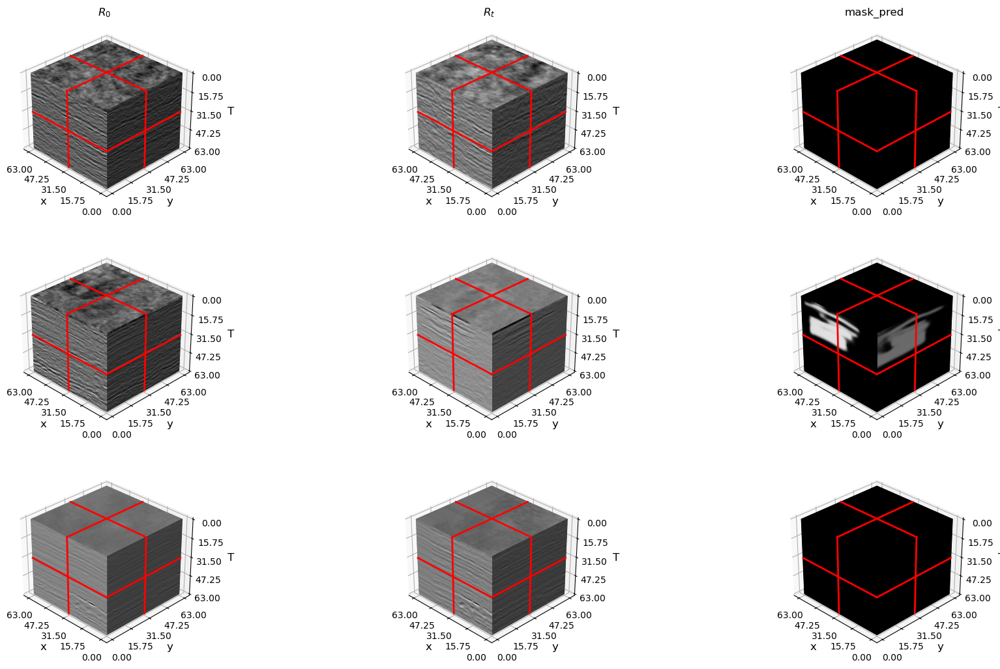

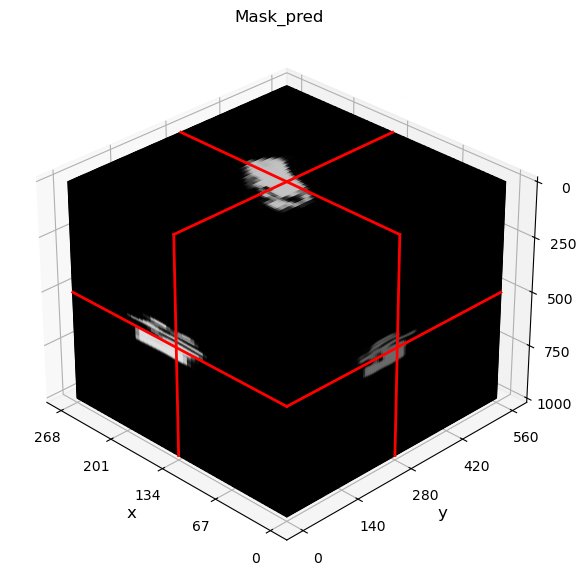

Horizontal slice Artifact above 600 ms for 2006_b01_t07:


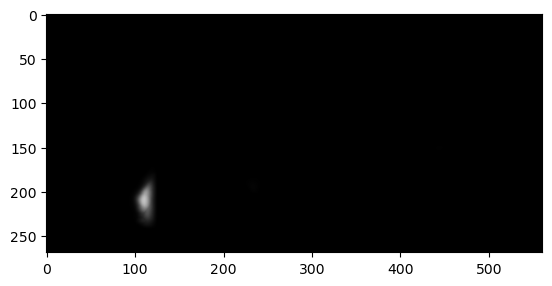

Horizontal slice Artifact below 1200 ms for 2006_b01_t07:


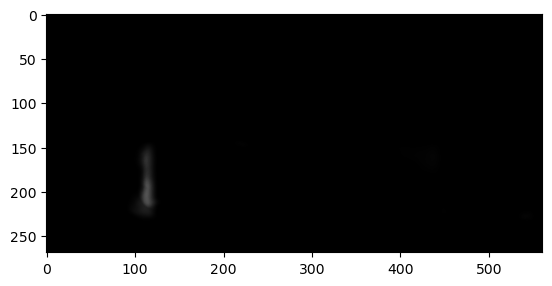

Inline assemble No. 134 for 2006_b01_t07:


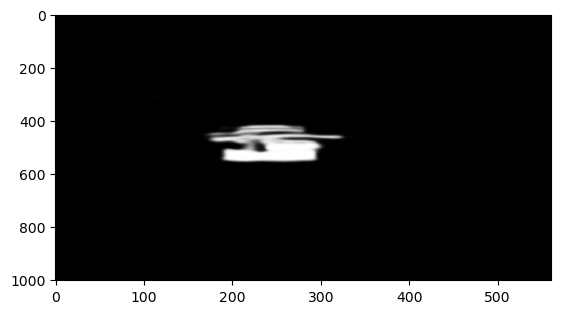

Testing year: 2008_b01_t08
Testing dataset size: 90
test_id_list for 2008_b01_t08: [22 45 67]
Runtime for 2008_b01_t08: 3.142791986465454 s


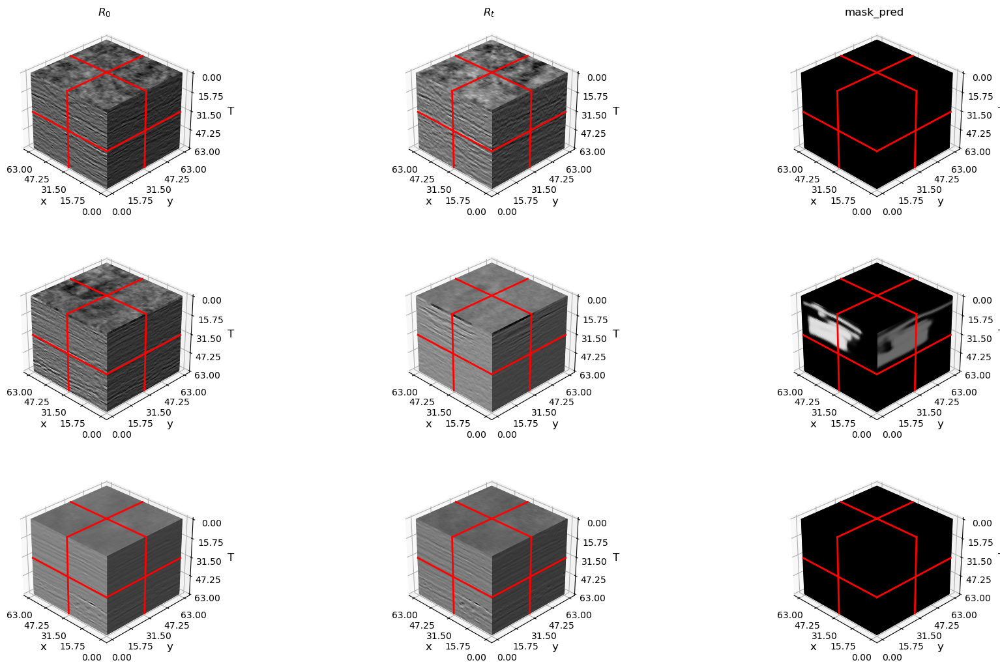

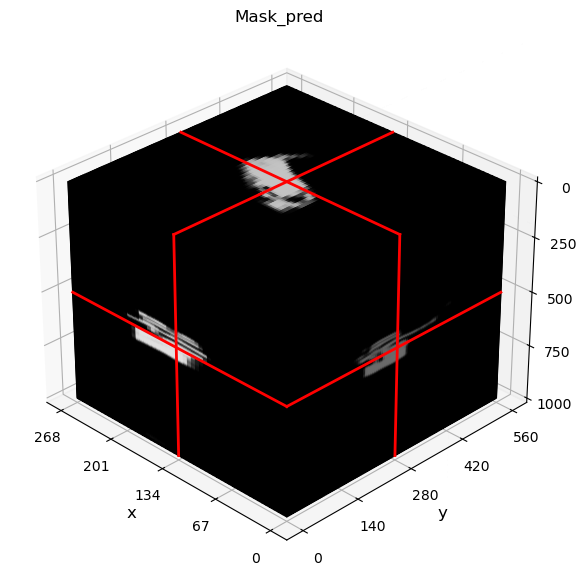

Horizontal slice Artifact above 600 ms for 2008_b01_t08:


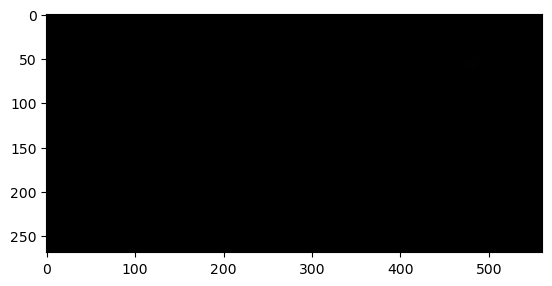

Horizontal slice Artifact below 1200 ms for 2008_b01_t08:


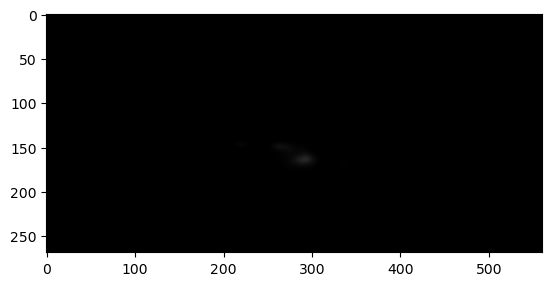

Inline assemble No. 134 for 2008_b01_t08:


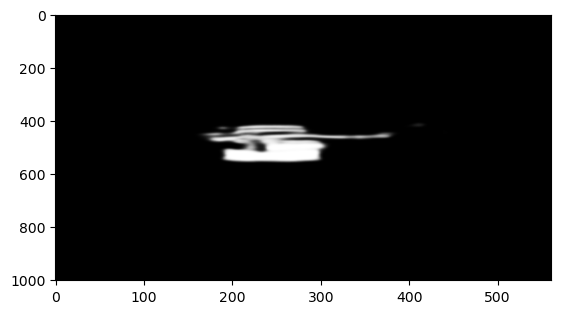

Testing year: 2010_b01_t10
Testing dataset size: 90
test_id_list for 2010_b01_t10: [22 45 67]
Runtime for 2010_b01_t10: 5.25683069229126 s


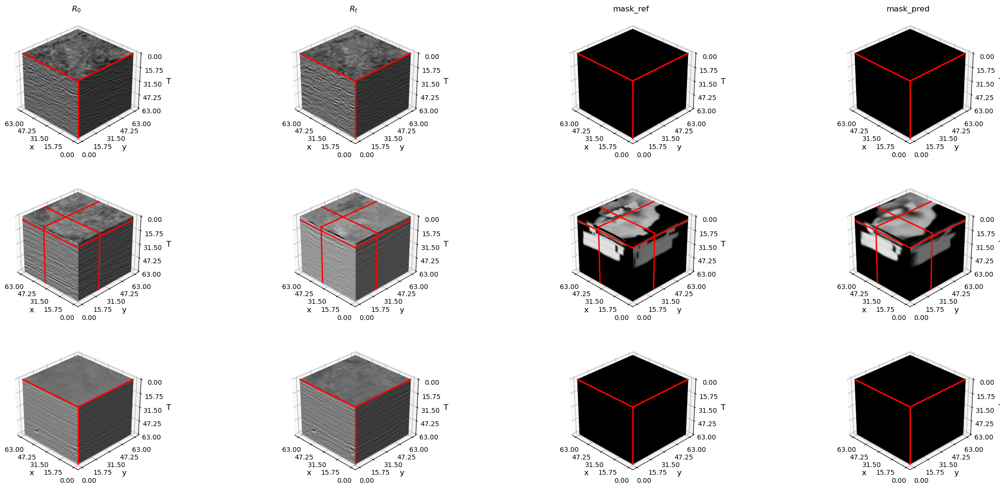

The prediction BCE loss for 2010_b01_t10 is 0.005068898666650057!


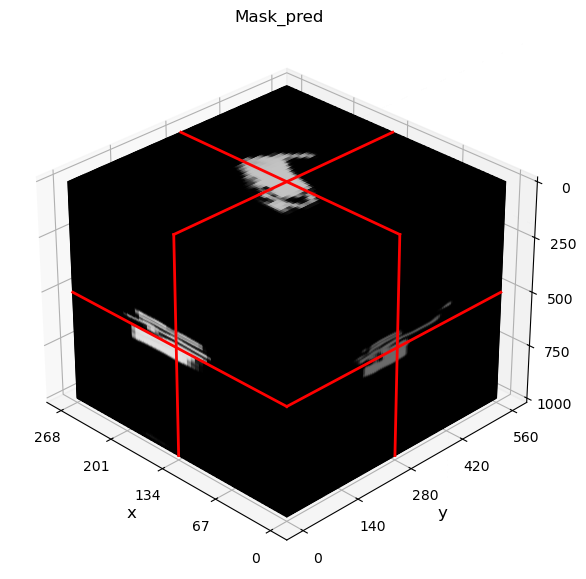

Horizontal slice Artifact above 600 ms for 2010_b01_t10:


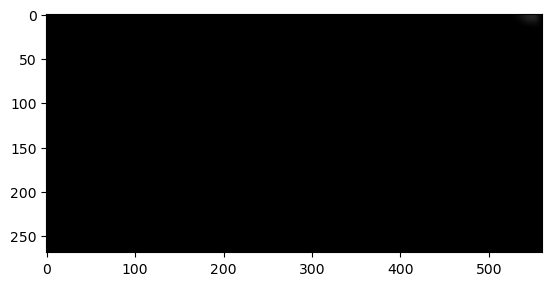

Horizontal slice Artifact below 1200 ms for 2010_b01_t10:


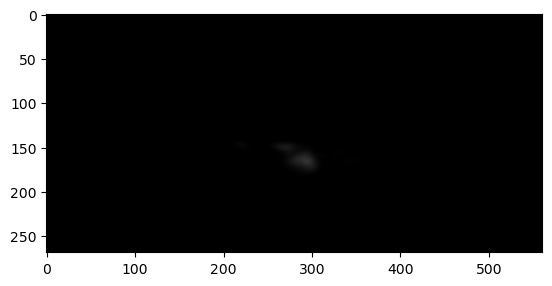

Inline assemble No. 134 for 2010_b01_t10:


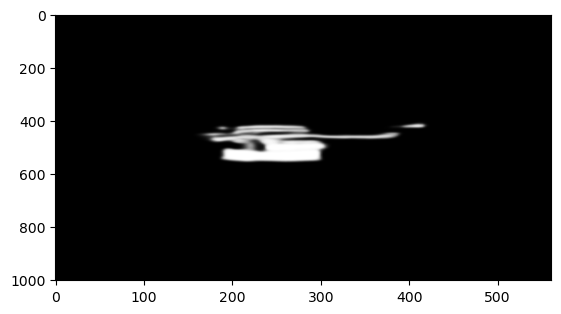

Reference Inline assemble No. 134 for 2010_b01_t10:


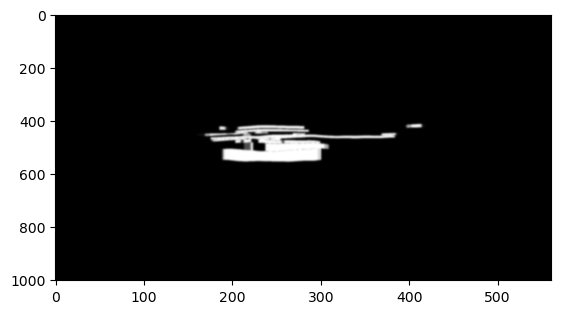

Testing year: 2010_b01_t11
Testing dataset size: 90
test_id_list for 2010_b01_t11: [22 45 67]
Runtime for 2010_b01_t11: 5.100165605545044 s


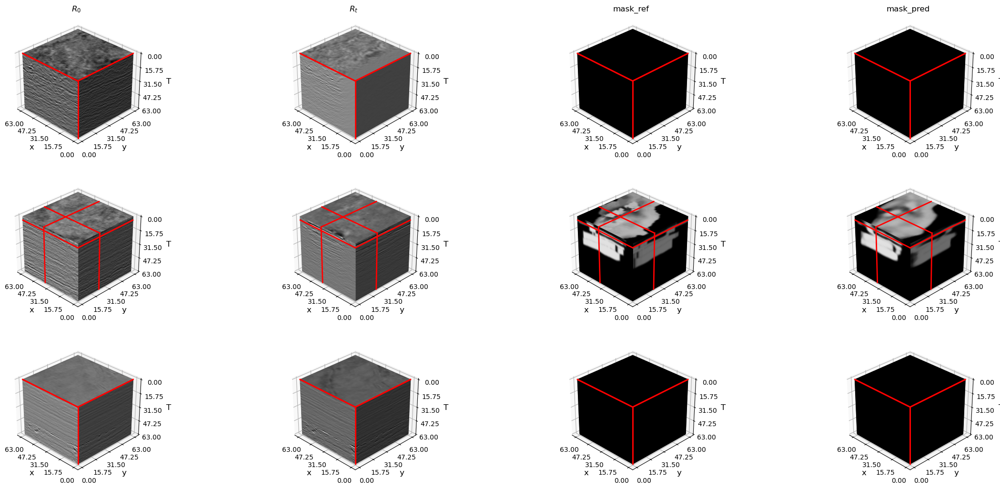

The prediction BCE loss for 2010_b01_t11 is 0.005157953593879938!


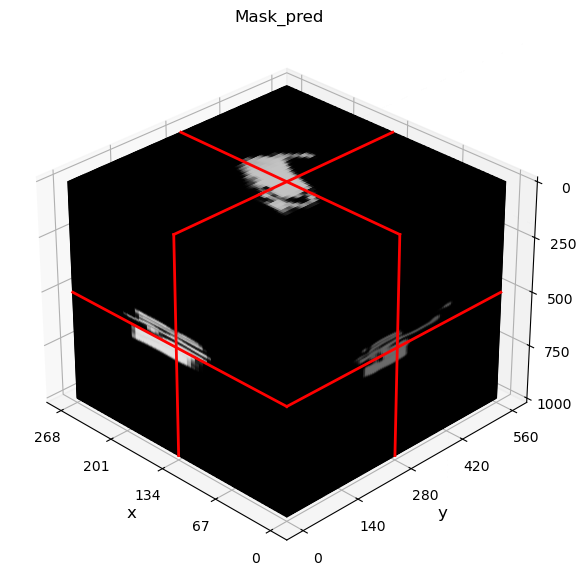

Horizontal slice Artifact above 600 ms for 2010_b01_t11:


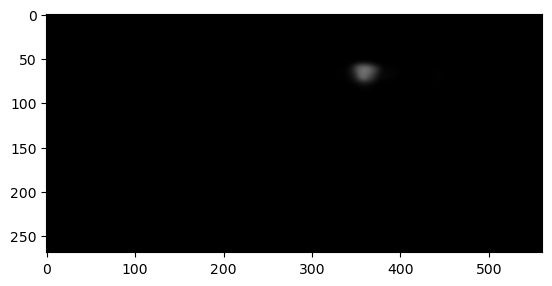

Horizontal slice Artifact below 1200 ms for 2010_b01_t11:


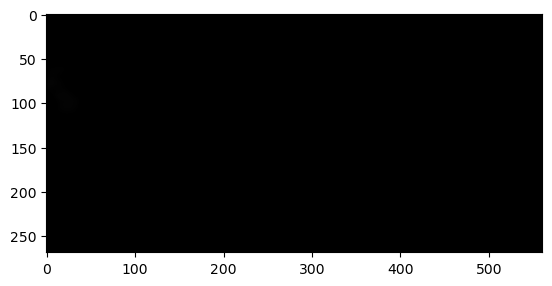

Inline assemble No. 134 for 2010_b01_t11:


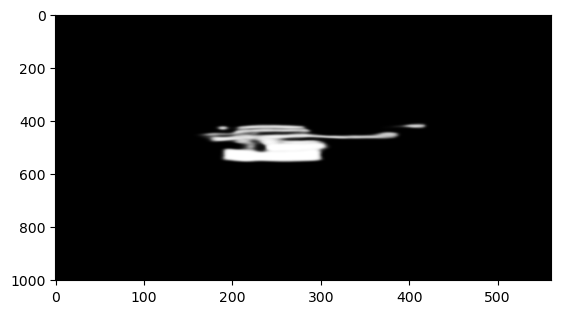

Reference Inline assemble No. 134 for 2010_b01_t11:


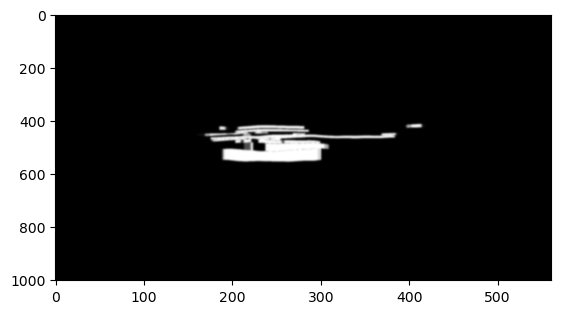

Testing year: 2010_b10_t10
Testing dataset size: 90
test_id_list for 2010_b10_t10: [22 45 67]
Runtime for 2010_b10_t10: 5.394408941268921 s


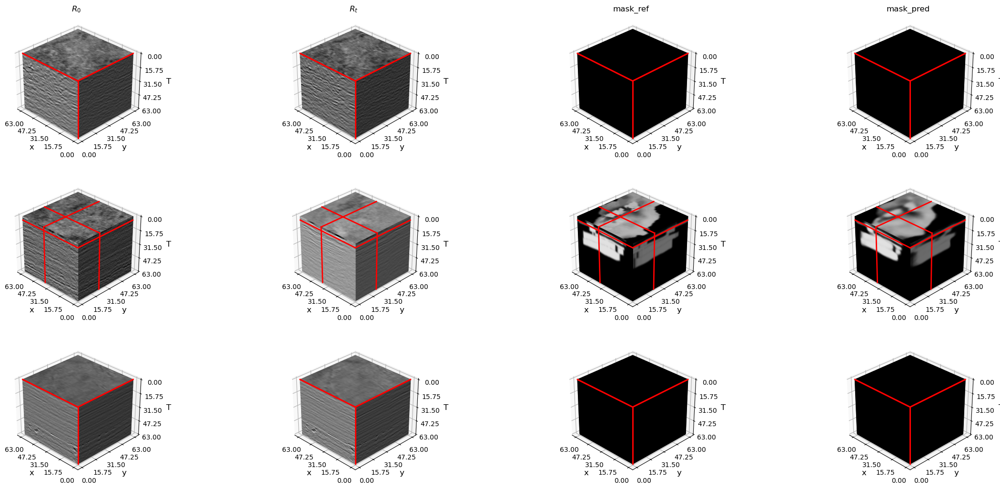

The prediction BCE loss for 2010_b10_t10 is 0.005089888349175453!


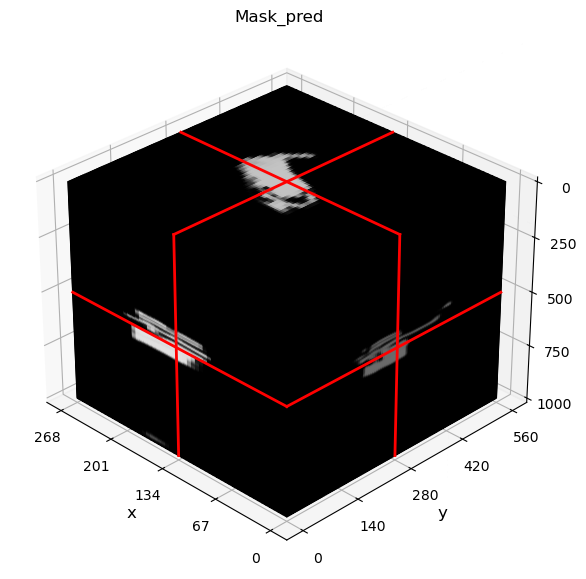

Horizontal slice Artifact above 600 ms for 2010_b10_t10:


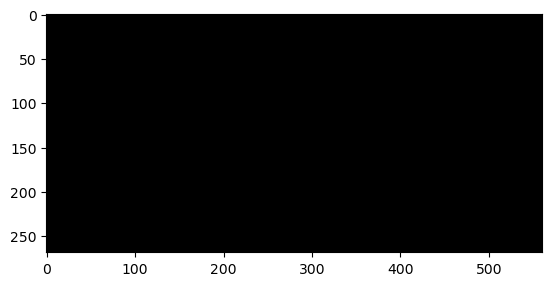

Horizontal slice Artifact below 1200 ms for 2010_b10_t10:


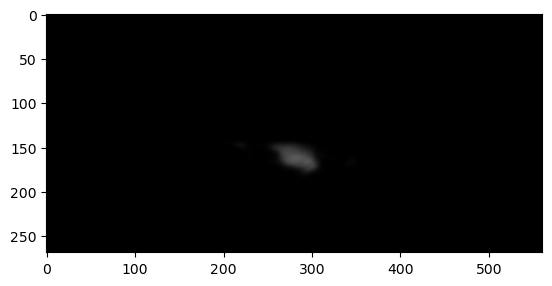

Inline assemble No. 134 for 2010_b10_t10:


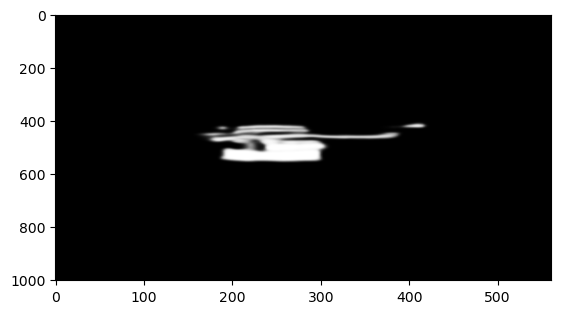

Reference Inline assemble No. 134 for 2010_b10_t10:


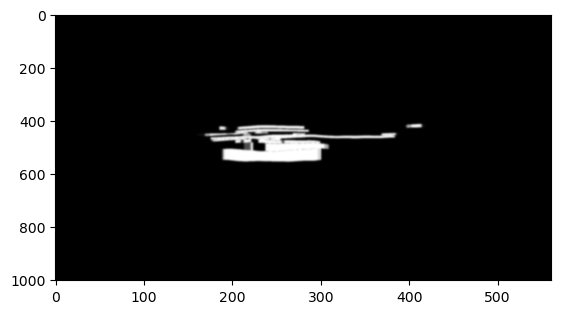

Testing year: 2010_b10_t11
Testing dataset size: 90
test_id_list for 2010_b10_t11: [22 45 67]
Runtime for 2010_b10_t11: 5.557695150375366 s


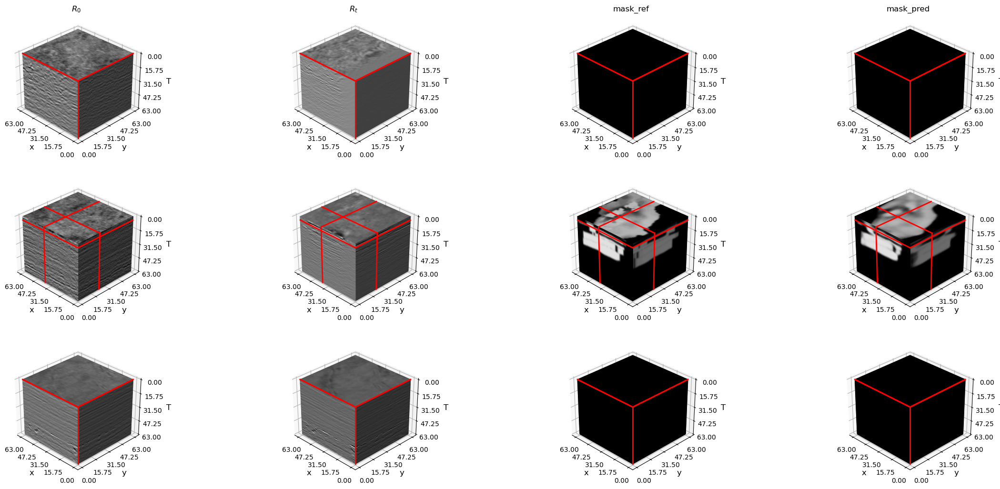

The prediction BCE loss for 2010_b10_t11 is 0.005147065967321396!


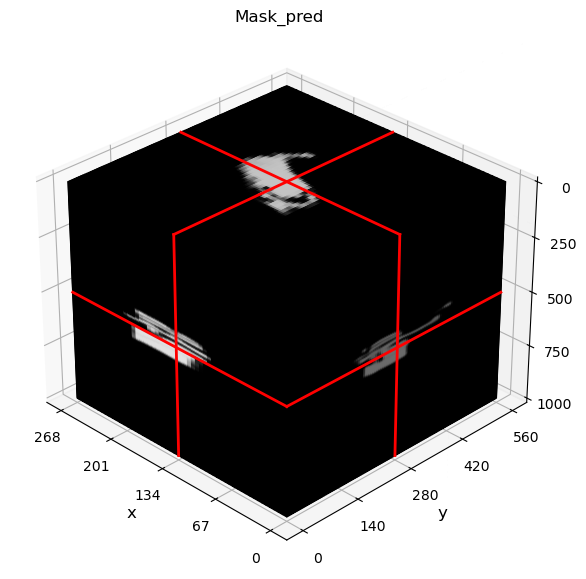

Horizontal slice Artifact above 600 ms for 2010_b10_t11:


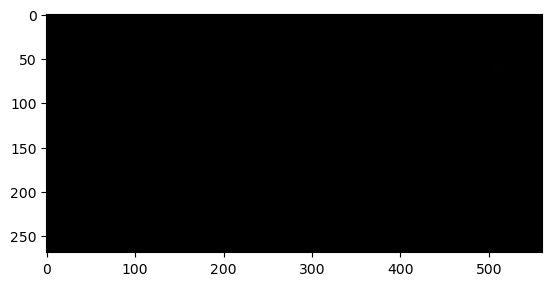

Horizontal slice Artifact below 1200 ms for 2010_b10_t11:


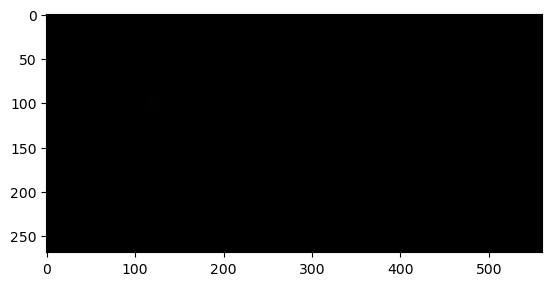

Inline assemble No. 134 for 2010_b10_t11:


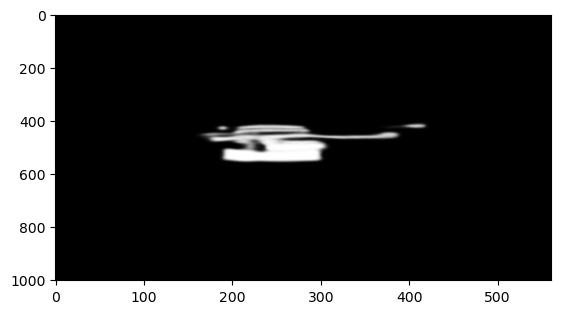

Reference Inline assemble No. 134 for 2010_b10_t11:


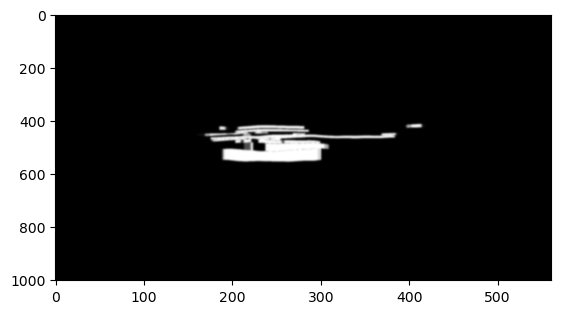

In [30]:
for year in yearlist:
    print(f'Testing year: {year}')
    # load test dataset
    root_test = f'{testpath}/{year}/test'
    if year[:4] == '2010':
        maskyear = True
    else:
        maskyear = False
    test = dataset_patch(root_test,pmf,pdf,mask=maskyear)
    Ntest = len(test)
    print(f'Testing dataset size: {Ntest}')
    # define the sampled patches in test dataset for display

    #test_id_list = np.random.choice(len(test),size=ndis_ts,replace=False)
    test_id_list = np.linspace(0,Ntest,ndis_ts+2,dtype=np.int16)[1:-1]
    pss = patch_show(test,test_id_list)
    print(f'test_id_list for {year}: {test_id_list}')
    
    # display the test patches
    #pss.view3d(rcstride=(1,1))
    
    # patch size
    rs = test.nsz
    # define the resize class for combining the predicted testing patches
    trs3 = resize3d(Ntest,D=test.osz[0],H=test.osz[1],W=test.osz[2])
    # loop through different batches in testing dataset
    loader_test = DataLoader(
         test
        ,batch_size = bs
        ,drop_last = False)
    # allocate memory for testing batches
    Tepred = np.zeros((ndis_ts,rs[0],rs[1],rs[2]))
    teMasks = torch.zeros((Ntest,1,rs[0],rs[1],rs[2]),dtype=torch.float32)
    Np = 0 # current accumulative number of patches
    
    ## record time runtime ##
    st = time.time()
    for batch in loader_test:
        if test.mask:
            R0t, _, idx = batch
        else:
            R0t, idx = batch
        # copy cpu data on GPU
        if cuda_gpu:
            R0t = R0t.cuda()
        # forward modeling
        bs = len(idx)
        Np += bs
        # find the indices of sampled testing patches in current batch for later display
        Idx = idx.tolist()
        cp = findtrace(test_id_list,Idx)
        # forward modeling
        with torch.no_grad():
            pMask = networktest(R0t)
        # record the sampled testing patches for later display
        for c,p in cp:
            Tepred[c] = pMask[p][0].cpu().detach().numpy()
        # save pMask for final combination
        teMasks[Np-bs:Np] = pMask.detach()
    
    ## record runtime ##
    et = time.time()
    print(f'Runtime for {year}: {et-st} s')
    
    # display the sampled patch fitting in validating dataset
    pss.view3d(Tepred,rcstride=(1,1))
    # combine pMask
    pMask_cb = patch_combine_3D(teMasks,test,trs3)
    # save pMask
    pMask_cb.tofile(f'{root_test}/tsMask.dat')
    teMasks.numpy().tofile(f'{root_test}/ts_patchMask.dat')
    if year[:4] == '2010':
        # calculate BCE loss for 2010 data
        pMask_cb[pMask_cb>1.0] = 1.0
        tmp = F.binary_cross_entropy(torch.tensor(pMask_cb),torch.tensor(masks))
        np.array(tmp).tofile(f'{root_test}/BCE_loss.dat')
        print(f'The prediction BCE loss for {year} is {tmp}!')
    # display the combined prediction in 3D
    fig = plt.figure(figsize=(9,7))
    ax = fig.add_subplot(1,1,1,projection='3d')
    _ = show3D(pMask_cb,ax=ax,xyzi=(test.DD[0]//2,test.DD[1]//2,test.DD[2]//2),
               clim=[0,1],rcstride=(5,5),tl=f'Mask_pred')
    plt.show()
    # display the combined prediction in slices
    print(f'Horizontal slice Artifact above 600 ms for {year}:')
    plt.imshow(np.max(pMask_cb[:,:,:300],axis=2),vmin=0,vmax=1,aspect=1,cmap='gray')
    plt.show()
    print(f'Horizontal slice Artifact below 1200 ms for {year}:')
    plt.imshow(np.max(pMask_cb[:,:,600:],axis=2),vmin=0,vmax=1,aspect=1,cmap='gray')
    plt.show()
    print(f'Inline assemble No. 134 for {year}:')
    plt.imshow(pMask_cb[134,:,:].T,vmin=0,vmax=1,aspect=0.3,cmap='gray')
    plt.show()
    if year[:4] == '2010':
        print(f'Reference Inline assemble No. 134 for {year}:')
        plt.imshow(masks[134,:,:].T,vmin=0,vmax=1,aspect=0.3,cmap='gray')
        plt.show()